In [1]:
# importing all the necessary libraries
import pandas as pd
import numpy as np 
import seaborn as sns
import re
import matplotlib.pyplot as plt 

In [2]:
# importing the csv file
df=pd.read_csv('laptop_details.csv')

In [3]:
df

,Product,Rating,MRP,Feature
0,Lenovo IdeaPad 3 Core i3 11th Gen - (8 GB/256 ...,4.2,"₹36,990",Intel Core i3 Processor (11th Gen)8 GB DDR4 RA...
1,Lenovo IdeaPad 3 Core i3 11th Gen - (8 GB/512 ...,4.2,"₹39,990",Intel Core i3 Processor (11th Gen)8 GB DDR4 RA...
2,ASUS VivoBook 15 (2022) Core i3 10th Gen - (8 ...,4.3,"₹32,990",Intel Core i3 Processor (10th Gen)8 GB DDR4 RA...
3,HP Pavilion Ryzen 5 Hexa Core AMD R5-5600H - (...,4.4,"₹49,990",AMD Ryzen 5 Hexa Core Processor8 GB DDR4 RAM64...
4,ASUS TUF Gaming F15 Core i5 10th Gen - (8 GB/5...,4.4,"₹49,990",Intel Core i5 Processor (10th Gen)8 GB DDR4 RA...
...,...,...,...,...
715,ASUS Chromebook Flip Touch Celeron Dual Core -...,4.0,"₹23,490",Intel Celeron Dual Core Processor4 GB LPDDR4 R...
716,Lenovo IdeaPad Gaming 3 Ryzen 7 Octa Core AMD ...,4.5,"₹73,490",AMD Ryzen 7 Octa Core Processor8 GB DDR4 RAM64...
717,ASUS ROG Zephyrus G15 Ryzen 9 Octa Core 6900HS...,NaN,"₹1,94,990",AMD Ryzen 9 Octa Core Processor16 GB DDR5 RAM6...
718,ASUS Zenbook Flip 14 OLED (2022) Touch Panel C...,3.0,"₹1,25,990",Intel Core i7 Processor (12th Gen)16 GB LPDDR5...


In [4]:
# for convinience purposes coverting the strings in the dataframe to lowercase
df['Product'] = df['Product'].apply(lambda x: x.lower())
df['Feature'] = df['Feature'].apply(lambda x: x.lower())

# removing the noise from MRP datapoints
df.MRP = df.MRP.apply(lambda x : x.replace('₹', '').replace(',', '')).astype(float)

In [5]:
df

,Product,Rating,MRP,Feature
0,lenovo ideapad 3 core i3 11th gen - (8 gb/256 ...,4.2,36990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...
1,lenovo ideapad 3 core i3 11th gen - (8 gb/512 ...,4.2,39990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...
2,asus vivobook 15 (2022) core i3 10th gen - (8 ...,4.3,32990.0,intel core i3 processor (10th gen)8 gb ddr4 ra...
3,hp pavilion ryzen 5 hexa core amd r5-5600h - (...,4.4,49990.0,amd ryzen 5 hexa core processor8 gb ddr4 ram64...
4,asus tuf gaming f15 core i5 10th gen - (8 gb/5...,4.4,49990.0,intel core i5 processor (10th gen)8 gb ddr4 ra...
...,...,...,...,...
715,asus chromebook flip touch celeron dual core -...,4.0,23490.0,intel celeron dual core processor4 gb lpddr4 r...
716,lenovo ideapad gaming 3 ryzen 7 octa core amd ...,4.5,73490.0,amd ryzen 7 octa core processor8 gb ddr4 ram64...
717,asus rog zephyrus g15 ryzen 9 octa core 6900hs...,NaN,194990.0,amd ryzen 9 octa core processor16 gb ddr5 ram6...
718,asus zenbook flip 14 oled (2022) touch panel c...,3.0,125990.0,intel core i7 processor (12th gen)16 gb lpddr5...


In [6]:
#extracting useful features from the given columns in the dataframe
split_text = lambda x: re.split('core|ryzen|intel|celeron|m1|m2|advantage|with|snapdragon|pentium|amd|dual|\(', x['Product'])[0]
df['brand']=df.apply(split_text,axis=1)


In [7]:
df['Brand']=df.apply(lambda x: re.split(' ', x['brand'])[0],axis=1)
df['model_name']=df.apply(lambda x: re.split(' ', x['brand'])[1:],axis=1)
df['model_name'] = df.apply(lambda x: ' '.join(map(str, x['model_name'])), axis=1)
df['model_name'].replace([''], np.nan, inplace=True)
df = df.drop('brand', axis=1)

In [8]:

pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
df

,Product,Rating,MRP,Feature,Brand,model_name
0,lenovo ideapad 3 core i3 11th gen - (8 gb/256 ...,4.2,36990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,lenovo,ideapad 3
1,lenovo ideapad 3 core i3 11th gen - (8 gb/512 ...,4.2,39990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,lenovo,ideapad 3
2,asus vivobook 15 (2022) core i3 10th gen - (8 ...,4.3,32990.0,intel core i3 processor (10th gen)8 gb ddr4 ra...,asus,vivobook 15
3,hp pavilion ryzen 5 hexa core amd r5-5600h - (...,4.4,49990.0,amd ryzen 5 hexa core processor8 gb ddr4 ram64...,hp,pavilion
4,asus tuf gaming f15 core i5 10th gen - (8 gb/5...,4.4,49990.0,intel core i5 processor (10th gen)8 gb ddr4 ra...,asus,tuf gaming f15
5,hp 14s intel core i3 11th gen - (8 gb/256 gb s...,4.2,36990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,hp,14s
6,dell inspiron core i3 11th gen - (8 gb/1 tb hd...,4.3,38990.0,processor: intel i3-1115g4 (base- 1.70 ghz & t...,dell,inspiron
7,redmibook pro core i5 11th gen - (8 gb/512 gb ...,4.1,39990.0,intel core i5 processor (11th gen)8 gb ddr4 ra...,redmibook,pro
8,realme book (slim) core i3 11th gen - (8 gb/25...,4.4,46990.0,stylish & portable thin and light laptop14 inc...,realme,book
9,asus vivobook 14 (2022) ryzen 7 quad core amd ...,4.1,44990.0,amd ryzen 7 quad core processor16 gb ddr4 ram6...,asus,vivobook 14


In [9]:
df['storage capacity']=df['Product'].apply(lambda x:re.findall('[0-9]+[ ]+(?:gb ram|gb ssd|tb ssd|gb hdd|tb hdd|gb emmc)',x))
df['storage capacity']=df['storage capacity'].apply(lambda x:','.join(x))
df['graphics']=df['Product'].apply(lambda x:re.findall('\d+\s*gb\s+graphics',x))
df['graphics']=df['graphics'].apply(lambda x:','.join(x))
df['graphics'].replace([''], np.nan, inplace=True)

In [10]:
regex_ = r'(?:amd|intel|m1|m2|qualcomm|apple)+[\w\s\d]+(?:processor)+'

df['Processor']=df['Feature'].apply(lambda x : re.findall(regex_, x)) 
df['Processor']=df['Processor'].apply(lambda x:','.join(x))

In [11]:
df

,Product,Rating,MRP,Feature,Brand,model_name,storage capacity,graphics,Processor
0,lenovo ideapad 3 core i3 11th gen - (8 gb/256 ...,4.2,36990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,lenovo,ideapad 3,256 gb ssd,NaN,intel core i3 processor
1,lenovo ideapad 3 core i3 11th gen - (8 gb/512 ...,4.2,39990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,lenovo,ideapad 3,512 gb ssd,NaN,intel core i3 processor
2,asus vivobook 15 (2022) core i3 10th gen - (8 ...,4.3,32990.0,intel core i3 processor (10th gen)8 gb ddr4 ra...,asus,vivobook 15,512 gb ssd,NaN,intel core i3 processor
3,hp pavilion ryzen 5 hexa core amd r5-5600h - (...,4.4,49990.0,amd ryzen 5 hexa core processor8 gb ddr4 ram64...,hp,pavilion,512 gb ssd,4 gb graphics,amd ryzen 5 hexa core processor
4,asus tuf gaming f15 core i5 10th gen - (8 gb/5...,4.4,49990.0,intel core i5 processor (10th gen)8 gb ddr4 ra...,asus,tuf gaming f15,512 gb ssd,4 gb graphics,intel core i5 processor
5,hp 14s intel core i3 11th gen - (8 gb/256 gb s...,4.2,36990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,hp,14s,256 gb ssd,NaN,intel core i3 processor
6,dell inspiron core i3 11th gen - (8 gb/1 tb hd...,4.3,38990.0,processor: intel i3-1115g4 (base- 1.70 ghz & t...,dell,inspiron,"1 tb hdd,256 gb ssd",NaN,intel optaneintel core i3 processor
7,redmibook pro core i5 11th gen - (8 gb/512 gb ...,4.1,39990.0,intel core i5 processor (11th gen)8 gb ddr4 ra...,redmibook,pro,512 gb ssd,NaN,intel core i5 processor
8,realme book (slim) core i3 11th gen - (8 gb/25...,4.4,46990.0,stylish & portable thin and light laptop14 inc...,realme,book,256 gb ssd,NaN,intel core i3 processor
9,asus vivobook 14 (2022) ryzen 7 quad core amd ...,4.1,44990.0,amd ryzen 7 quad core processor16 gb ddr4 ram6...,asus,vivobook 14,512 gb ssd,NaN,amd ryzen 7 quad core processor


In [12]:
df["gen"]=df['Feature'].apply(lambda x : re.findall(r"[\w\s\d]+(?:gen)+", x)) 
df["gen"]=df["gen"].apply(lambda x:','.join(x))
df["gen"].replace([''], np.nan, inplace=True)


In [13]:
df

,Product,Rating,MRP,Feature,Brand,model_name,storage capacity,graphics,Processor,gen
0,lenovo ideapad 3 core i3 11th gen - (8 gb/256 ...,4.2,36990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,lenovo,ideapad 3,256 gb ssd,NaN,intel core i3 processor,11th gen
1,lenovo ideapad 3 core i3 11th gen - (8 gb/512 ...,4.2,39990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,lenovo,ideapad 3,512 gb ssd,NaN,intel core i3 processor,11th gen
2,asus vivobook 15 (2022) core i3 10th gen - (8 ...,4.3,32990.0,intel core i3 processor (10th gen)8 gb ddr4 ra...,asus,vivobook 15,512 gb ssd,NaN,intel core i3 processor,10th gen
3,hp pavilion ryzen 5 hexa core amd r5-5600h - (...,4.4,49990.0,amd ryzen 5 hexa core processor8 gb ddr4 ram64...,hp,pavilion,512 gb ssd,4 gb graphics,amd ryzen 5 hexa core processor,NaN
4,asus tuf gaming f15 core i5 10th gen - (8 gb/5...,4.4,49990.0,intel core i5 processor (10th gen)8 gb ddr4 ra...,asus,tuf gaming f15,512 gb ssd,4 gb graphics,intel core i5 processor,10th gen
5,hp 14s intel core i3 11th gen - (8 gb/256 gb s...,4.2,36990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,hp,14s,256 gb ssd,NaN,intel core i3 processor,11th gen
6,dell inspiron core i3 11th gen - (8 gb/1 tb hd...,4.3,38990.0,processor: intel i3-1115g4 (base- 1.70 ghz & t...,dell,inspiron,"1 tb hdd,256 gb ssd",NaN,intel optaneintel core i3 processor,"2 gen,11th gen"
7,redmibook pro core i5 11th gen - (8 gb/512 gb ...,4.1,39990.0,intel core i5 processor (11th gen)8 gb ddr4 ra...,redmibook,pro,512 gb ssd,NaN,intel core i5 processor,11th gen
8,realme book (slim) core i3 11th gen - (8 gb/25...,4.4,46990.0,stylish & portable thin and light laptop14 inc...,realme,book,256 gb ssd,NaN,intel core i3 processor,11th gen
9,asus vivobook 14 (2022) ryzen 7 quad core amd ...,4.1,44990.0,amd ryzen 7 quad core processor16 gb ddr4 ram6...,asus,vivobook 14,512 gb ssd,NaN,amd ryzen 7 quad core processor,NaN


In [14]:
# storage partitioning dividing the storage cpacity columns into ssd hdd and emmc

# emmc
df['emmc type']=df['storage capacity'].apply(lambda x:re.findall('[0-9]+[ ]+(?:gb|tb)+[ ]+(?:emmc)+',x))
df['emmc type']=df['emmc type'].apply(lambda x:','.join(x) )
df['emmc type'].replace([''], np.nan, inplace=True)

#ssd
df['ssd type']=df['storage capacity'].apply(lambda x:re.findall('[0-9]+[ ]+(?:gb|tb)+[ ]+(?:ssd)+',x))
df['ssd type']=df['ssd type'].apply(lambda x:','.join(x))
df['ssd type'].replace([''], np.nan, inplace=True)

#hdd
df['hdd type']=df['storage capacity'].apply(lambda x:re.findall('[0-9]+[ ]+(?:gb|tb)+[ ]+(?:hdd)+',x))
df['hdd type']=df['hdd type'].apply(lambda x:','.join(x))
df['hdd type'].replace([''], np.nan, inplace=True)

#dropping the original column
df.drop('storage capacity',axis=1,inplace=True)

In [15]:
df

,Product,Rating,MRP,Feature,Brand,model_name,graphics,Processor,gen,emmc type,ssd type,hdd type
0,lenovo ideapad 3 core i3 11th gen - (8 gb/256 ...,4.2,36990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,lenovo,ideapad 3,NaN,intel core i3 processor,11th gen,NaN,256 gb ssd,NaN
1,lenovo ideapad 3 core i3 11th gen - (8 gb/512 ...,4.2,39990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,lenovo,ideapad 3,NaN,intel core i3 processor,11th gen,NaN,512 gb ssd,NaN
2,asus vivobook 15 (2022) core i3 10th gen - (8 ...,4.3,32990.0,intel core i3 processor (10th gen)8 gb ddr4 ra...,asus,vivobook 15,NaN,intel core i3 processor,10th gen,NaN,512 gb ssd,NaN
3,hp pavilion ryzen 5 hexa core amd r5-5600h - (...,4.4,49990.0,amd ryzen 5 hexa core processor8 gb ddr4 ram64...,hp,pavilion,4 gb graphics,amd ryzen 5 hexa core processor,NaN,NaN,512 gb ssd,NaN
4,asus tuf gaming f15 core i5 10th gen - (8 gb/5...,4.4,49990.0,intel core i5 processor (10th gen)8 gb ddr4 ra...,asus,tuf gaming f15,4 gb graphics,intel core i5 processor,10th gen,NaN,512 gb ssd,NaN
5,hp 14s intel core i3 11th gen - (8 gb/256 gb s...,4.2,36990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,hp,14s,NaN,intel core i3 processor,11th gen,NaN,256 gb ssd,NaN
6,dell inspiron core i3 11th gen - (8 gb/1 tb hd...,4.3,38990.0,processor: intel i3-1115g4 (base- 1.70 ghz & t...,dell,inspiron,NaN,intel optaneintel core i3 processor,"2 gen,11th gen",NaN,256 gb ssd,1 tb hdd
7,redmibook pro core i5 11th gen - (8 gb/512 gb ...,4.1,39990.0,intel core i5 processor (11th gen)8 gb ddr4 ra...,redmibook,pro,NaN,intel core i5 processor,11th gen,NaN,512 gb ssd,NaN
8,realme book (slim) core i3 11th gen - (8 gb/25...,4.4,46990.0,stylish & portable thin and light laptop14 inc...,realme,book,NaN,intel core i3 processor,11th gen,NaN,256 gb ssd,NaN
9,asus vivobook 14 (2022) ryzen 7 quad core amd ...,4.1,44990.0,amd ryzen 7 quad core processor16 gb ddr4 ram6...,asus,vivobook 14,NaN,amd ryzen 7 quad core processor,NaN,NaN,512 gb ssd,NaN


In [16]:
df['processor brand']=df['Processor'].apply(lambda x:re.findall(r'^[^\w]*\w+',x))
df['processor brand']=df['processor brand'].apply(lambda x:','.join(x) )
df['processor brand'].replace([''], np.nan, inplace=True)

In [17]:
df['processor line']=df['Processor'].apply(lambda x:re.sub(r'^[^\w]*\w+','',x))

df['processor line'].replace([''], np.nan, inplace=True)

In [18]:
df

,Product,Rating,MRP,Feature,Brand,model_name,graphics,Processor,gen,emmc type,ssd type,hdd type,processor brand,processor line
0,lenovo ideapad 3 core i3 11th gen - (8 gb/256 ...,4.2,36990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,lenovo,ideapad 3,NaN,intel core i3 processor,11th gen,NaN,256 gb ssd,NaN,intel,core i3 processor
1,lenovo ideapad 3 core i3 11th gen - (8 gb/512 ...,4.2,39990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,lenovo,ideapad 3,NaN,intel core i3 processor,11th gen,NaN,512 gb ssd,NaN,intel,core i3 processor
2,asus vivobook 15 (2022) core i3 10th gen - (8 ...,4.3,32990.0,intel core i3 processor (10th gen)8 gb ddr4 ra...,asus,vivobook 15,NaN,intel core i3 processor,10th gen,NaN,512 gb ssd,NaN,intel,core i3 processor
3,hp pavilion ryzen 5 hexa core amd r5-5600h - (...,4.4,49990.0,amd ryzen 5 hexa core processor8 gb ddr4 ram64...,hp,pavilion,4 gb graphics,amd ryzen 5 hexa core processor,NaN,NaN,512 gb ssd,NaN,amd,ryzen 5 hexa core processor
4,asus tuf gaming f15 core i5 10th gen - (8 gb/5...,4.4,49990.0,intel core i5 processor (10th gen)8 gb ddr4 ra...,asus,tuf gaming f15,4 gb graphics,intel core i5 processor,10th gen,NaN,512 gb ssd,NaN,intel,core i5 processor
5,hp 14s intel core i3 11th gen - (8 gb/256 gb s...,4.2,36990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,hp,14s,NaN,intel core i3 processor,11th gen,NaN,256 gb ssd,NaN,intel,core i3 processor
6,dell inspiron core i3 11th gen - (8 gb/1 tb hd...,4.3,38990.0,processor: intel i3-1115g4 (base- 1.70 ghz & t...,dell,inspiron,NaN,intel optaneintel core i3 processor,"2 gen,11th gen",NaN,256 gb ssd,1 tb hdd,intel,optaneintel core i3 processor
7,redmibook pro core i5 11th gen - (8 gb/512 gb ...,4.1,39990.0,intel core i5 processor (11th gen)8 gb ddr4 ra...,redmibook,pro,NaN,intel core i5 processor,11th gen,NaN,512 gb ssd,NaN,intel,core i5 processor
8,realme book (slim) core i3 11th gen - (8 gb/25...,4.4,46990.0,stylish & portable thin and light laptop14 inc...,realme,book,NaN,intel core i3 processor,11th gen,NaN,256 gb ssd,NaN,intel,core i3 processor
9,asus vivobook 14 (2022) ryzen 7 quad core amd ...,4.1,44990.0,amd ryzen 7 quad core processor16 gb ddr4 ram6...,asus,vivobook 14,NaN,amd ryzen 7 quad core processor,NaN,NaN,512 gb ssd,NaN,amd,ryzen 7 quad core processor


In [19]:
df['processor line'].unique()

array([' core i3 processor', ' ryzen 5 hexa core processor',
       ' core i5 processor', ' optaneintel core i3 processor',
       ' ryzen 7 quad core processor', ' ryzen 5 quad core processor',
       ' ryzen 9 octa core processor', ' ryzen 7 octa core processor',
       ' m1 processor', ' celeron dual core processor',
       ' ryzen 3 dual core processor', ' athlon dual core processor',
       ' evo core i5 processor,intel core i5 processor',
       ' ryzen 3 quad core processor', ' m2 processor',
       ' celeron quad core processor', ' core i7 processor',
       ' m1 pro processor', ' snapdragon 7c gen 2 processor',
       ' pentium silver processor', ' m1 max processor',
       ' core i9 processor', ' ryzen 5 dual core processor',
       ' pentium quad core processor', ' dual core processor',
       ' ryzen 3 hexa core processor'], dtype=object)

In [20]:
print(df['processor line'].value_counts()[' optaneintel core i3 processor'])
df.loc[df['processor line']==' dual core processor']
    

2


,Product,Rating,MRP,Feature,Brand,model_name,graphics,Processor,gen,emmc type,ssd type,hdd type,processor brand,processor line
575,lenovo ideapad 3 dual core 3020e - (4 gb/1 tb ...,4.0,27490.0,amd dual core processor4 gb ddr4 ram64 bit win...,lenovo,ideapad 3,NaN,amd dual core processor,NaN,NaN,NaN,1 tb hdd,amd,dual core processor


In [21]:
df['processor line']=df['processor line'].replace (' evo core i5 processor,intel core i5 processor', 'core i5 processor')

df['processor line']=df['processor line'].replace (' optaneintel core i3 processor', 'core i3 processor')
df['processor line']=df['processor line'].replace (' dual core processor', '3020e dual core')
df

,Product,Rating,MRP,Feature,Brand,model_name,graphics,Processor,gen,emmc type,ssd type,hdd type,processor brand,processor line
0,lenovo ideapad 3 core i3 11th gen - (8 gb/256 ...,4.2,36990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,lenovo,ideapad 3,NaN,intel core i3 processor,11th gen,NaN,256 gb ssd,NaN,intel,core i3 processor
1,lenovo ideapad 3 core i3 11th gen - (8 gb/512 ...,4.2,39990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,lenovo,ideapad 3,NaN,intel core i3 processor,11th gen,NaN,512 gb ssd,NaN,intel,core i3 processor
2,asus vivobook 15 (2022) core i3 10th gen - (8 ...,4.3,32990.0,intel core i3 processor (10th gen)8 gb ddr4 ra...,asus,vivobook 15,NaN,intel core i3 processor,10th gen,NaN,512 gb ssd,NaN,intel,core i3 processor
3,hp pavilion ryzen 5 hexa core amd r5-5600h - (...,4.4,49990.0,amd ryzen 5 hexa core processor8 gb ddr4 ram64...,hp,pavilion,4 gb graphics,amd ryzen 5 hexa core processor,NaN,NaN,512 gb ssd,NaN,amd,ryzen 5 hexa core processor
4,asus tuf gaming f15 core i5 10th gen - (8 gb/5...,4.4,49990.0,intel core i5 processor (10th gen)8 gb ddr4 ra...,asus,tuf gaming f15,4 gb graphics,intel core i5 processor,10th gen,NaN,512 gb ssd,NaN,intel,core i5 processor
5,hp 14s intel core i3 11th gen - (8 gb/256 gb s...,4.2,36990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,hp,14s,NaN,intel core i3 processor,11th gen,NaN,256 gb ssd,NaN,intel,core i3 processor
6,dell inspiron core i3 11th gen - (8 gb/1 tb hd...,4.3,38990.0,processor: intel i3-1115g4 (base- 1.70 ghz & t...,dell,inspiron,NaN,intel optaneintel core i3 processor,"2 gen,11th gen",NaN,256 gb ssd,1 tb hdd,intel,core i3 processor
7,redmibook pro core i5 11th gen - (8 gb/512 gb ...,4.1,39990.0,intel core i5 processor (11th gen)8 gb ddr4 ra...,redmibook,pro,NaN,intel core i5 processor,11th gen,NaN,512 gb ssd,NaN,intel,core i5 processor
8,realme book (slim) core i3 11th gen - (8 gb/25...,4.4,46990.0,stylish & portable thin and light laptop14 inc...,realme,book,NaN,intel core i3 processor,11th gen,NaN,256 gb ssd,NaN,intel,core i3 processor
9,asus vivobook 14 (2022) ryzen 7 quad core amd ...,4.1,44990.0,amd ryzen 7 quad core processor16 gb ddr4 ram6...,asus,vivobook 14,NaN,amd ryzen 7 quad core processor,NaN,NaN,512 gb ssd,NaN,amd,ryzen 7 quad core processor


In [22]:
df['processor line'].unique()

array([' core i3 processor', ' ryzen 5 hexa core processor',
       ' core i5 processor', 'core i3 processor',
       ' ryzen 7 quad core processor', ' ryzen 5 quad core processor',
       ' ryzen 9 octa core processor', ' ryzen 7 octa core processor',
       ' m1 processor', ' celeron dual core processor',
       ' ryzen 3 dual core processor', ' athlon dual core processor',
       'core i5 processor', ' ryzen 3 quad core processor',
       ' m2 processor', ' celeron quad core processor',
       ' core i7 processor', ' m1 pro processor',
       ' snapdragon 7c gen 2 processor', ' pentium silver processor',
       ' m1 max processor', ' core i9 processor',
       ' ryzen 5 dual core processor', ' pentium quad core processor',
       '3020e dual core', ' ryzen 3 hexa core processor'], dtype=object)

In [23]:
df['graphics'].unique()

array([nan, '4 gb graphics', '8 gb graphics', '6 gb graphics',
       '2 gb graphics', '16 gb graphics'], dtype=object)

In [24]:
df.drop('Processor',axis=1,inplace=True)
df

,Product,Rating,MRP,Feature,Brand,model_name,graphics,gen,emmc type,ssd type,hdd type,processor brand,processor line
0,lenovo ideapad 3 core i3 11th gen - (8 gb/256 ...,4.2,36990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,lenovo,ideapad 3,NaN,11th gen,NaN,256 gb ssd,NaN,intel,core i3 processor
1,lenovo ideapad 3 core i3 11th gen - (8 gb/512 ...,4.2,39990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,lenovo,ideapad 3,NaN,11th gen,NaN,512 gb ssd,NaN,intel,core i3 processor
2,asus vivobook 15 (2022) core i3 10th gen - (8 ...,4.3,32990.0,intel core i3 processor (10th gen)8 gb ddr4 ra...,asus,vivobook 15,NaN,10th gen,NaN,512 gb ssd,NaN,intel,core i3 processor
3,hp pavilion ryzen 5 hexa core amd r5-5600h - (...,4.4,49990.0,amd ryzen 5 hexa core processor8 gb ddr4 ram64...,hp,pavilion,4 gb graphics,NaN,NaN,512 gb ssd,NaN,amd,ryzen 5 hexa core processor
4,asus tuf gaming f15 core i5 10th gen - (8 gb/5...,4.4,49990.0,intel core i5 processor (10th gen)8 gb ddr4 ra...,asus,tuf gaming f15,4 gb graphics,10th gen,NaN,512 gb ssd,NaN,intel,core i5 processor
5,hp 14s intel core i3 11th gen - (8 gb/256 gb s...,4.2,36990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,hp,14s,NaN,11th gen,NaN,256 gb ssd,NaN,intel,core i3 processor
6,dell inspiron core i3 11th gen - (8 gb/1 tb hd...,4.3,38990.0,processor: intel i3-1115g4 (base- 1.70 ghz & t...,dell,inspiron,NaN,"2 gen,11th gen",NaN,256 gb ssd,1 tb hdd,intel,core i3 processor
7,redmibook pro core i5 11th gen - (8 gb/512 gb ...,4.1,39990.0,intel core i5 processor (11th gen)8 gb ddr4 ra...,redmibook,pro,NaN,11th gen,NaN,512 gb ssd,NaN,intel,core i5 processor
8,realme book (slim) core i3 11th gen - (8 gb/25...,4.4,46990.0,stylish & portable thin and light laptop14 inc...,realme,book,NaN,11th gen,NaN,256 gb ssd,NaN,intel,core i3 processor
9,asus vivobook 14 (2022) ryzen 7 quad core amd ...,4.1,44990.0,amd ryzen 7 quad core processor16 gb ddr4 ram6...,asus,vivobook 14,NaN,NaN,NaN,512 gb ssd,NaN,amd,ryzen 7 quad core processor


In [25]:
#df['RAM']=df['Feature'].apply(lambda x:re.findall('[0-9]+[\s]+(?:GB)+[\s]+(?:DDR4|DDR5|LPDDR4|Unified Memory|LPDDR4X|LPDDR5|LPDDR3)+[\s]+(?:RAM)+',x))

In [26]:
df

,Product,Rating,MRP,Feature,Brand,model_name,graphics,gen,emmc type,ssd type,hdd type,processor brand,processor line
0,lenovo ideapad 3 core i3 11th gen - (8 gb/256 ...,4.2,36990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,lenovo,ideapad 3,NaN,11th gen,NaN,256 gb ssd,NaN,intel,core i3 processor
1,lenovo ideapad 3 core i3 11th gen - (8 gb/512 ...,4.2,39990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,lenovo,ideapad 3,NaN,11th gen,NaN,512 gb ssd,NaN,intel,core i3 processor
2,asus vivobook 15 (2022) core i3 10th gen - (8 ...,4.3,32990.0,intel core i3 processor (10th gen)8 gb ddr4 ra...,asus,vivobook 15,NaN,10th gen,NaN,512 gb ssd,NaN,intel,core i3 processor
3,hp pavilion ryzen 5 hexa core amd r5-5600h - (...,4.4,49990.0,amd ryzen 5 hexa core processor8 gb ddr4 ram64...,hp,pavilion,4 gb graphics,NaN,NaN,512 gb ssd,NaN,amd,ryzen 5 hexa core processor
4,asus tuf gaming f15 core i5 10th gen - (8 gb/5...,4.4,49990.0,intel core i5 processor (10th gen)8 gb ddr4 ra...,asus,tuf gaming f15,4 gb graphics,10th gen,NaN,512 gb ssd,NaN,intel,core i5 processor
5,hp 14s intel core i3 11th gen - (8 gb/256 gb s...,4.2,36990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,hp,14s,NaN,11th gen,NaN,256 gb ssd,NaN,intel,core i3 processor
6,dell inspiron core i3 11th gen - (8 gb/1 tb hd...,4.3,38990.0,processor: intel i3-1115g4 (base- 1.70 ghz & t...,dell,inspiron,NaN,"2 gen,11th gen",NaN,256 gb ssd,1 tb hdd,intel,core i3 processor
7,redmibook pro core i5 11th gen - (8 gb/512 gb ...,4.1,39990.0,intel core i5 processor (11th gen)8 gb ddr4 ra...,redmibook,pro,NaN,11th gen,NaN,512 gb ssd,NaN,intel,core i5 processor
8,realme book (slim) core i3 11th gen - (8 gb/25...,4.4,46990.0,stylish & portable thin and light laptop14 inc...,realme,book,NaN,11th gen,NaN,256 gb ssd,NaN,intel,core i3 processor
9,asus vivobook 14 (2022) ryzen 7 quad core amd ...,4.1,44990.0,amd ryzen 7 quad core processor16 gb ddr4 ram6...,asus,vivobook 14,NaN,NaN,NaN,512 gb ssd,NaN,amd,ryzen 7 quad core processor


In [27]:
df["gen"].unique()

array(['11th gen', '10th gen', nan, '2 gen,11th gen', '12th gen',
       'powered by 11th gen,11th gen', '0 gen', '5th gen',
       'qualcomm snapdragon 7c gen', '2 gen', '4th gen',
       'installed gen,11th gen', '3rd gen', '2 gen,2 gen,11th gen',
       '9th gen', ' 11th gen,2 gen,11th gen', ' 10th gen,2 gen,10th gen',
       '8th gen', '11th gen,e gen', 'installed gen,7th gen'], dtype=object)

In [28]:
df.loc[df['gen']=='installed gen,7th gen']

,Product,Rating,MRP,Feature,Brand,model_name,graphics,gen,emmc type,ssd type,hdd type,processor brand,processor line
438,acer predator helios 300 core i5 7th gen - (8 ...,4.5,129999.0,pre-installed genuine windows 10 operating sys...,acer,predator helios 300,4 gb graphics,"installed gen,7th gen",NaN,128 gb ssd,1 tb hdd,intel,core i5 processor


In [29]:
df['gen']=df['gen'].replace('2 gen,11th gen','11th gen')
df['gen']=df['gen'].replace('powered by 11th gen,11th gen','11th gen')
df['gen']=df['gen'].replace('0 gen',np.nan)
df['gen']=df['gen'].replace('installed gen,11th gen','11th gen')
df['gen']=df['gen'].replace('2 gen,2 gen,11th gen','11th gen')
df['gen']=df['gen'].replace(' 11th gen,2 gen,11th gen','11th gen')
df['gen']=df['gen'].replace(' 10th gen,2 gen,10th gen','10th gen')
df['gen']=df['gen'].replace('11th gen,e gen','11th gen')
df['gen']=df['gen'].replace('installed gen,7th gen','7th gen')

In [30]:
df['gen'].unique()

array(['11th gen', '10th gen', nan, '12th gen', '5th gen',
       'qualcomm snapdragon 7c gen', '2 gen', '4th gen', '3rd gen',
       '9th gen', '8th gen', '7th gen'], dtype=object)

In [31]:
df['gen']=df['gen'].replace(np.nan,'')

In [32]:
df['processor']=df['gen']+' '+df['processor line']

In [33]:
df

,Product,Rating,MRP,Feature,Brand,model_name,graphics,gen,emmc type,ssd type,hdd type,processor brand,processor line,processor
0,lenovo ideapad 3 core i3 11th gen - (8 gb/256 ...,4.2,36990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,lenovo,ideapad 3,NaN,11th gen,NaN,256 gb ssd,NaN,intel,core i3 processor,11th gen core i3 processor
1,lenovo ideapad 3 core i3 11th gen - (8 gb/512 ...,4.2,39990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,lenovo,ideapad 3,NaN,11th gen,NaN,512 gb ssd,NaN,intel,core i3 processor,11th gen core i3 processor
2,asus vivobook 15 (2022) core i3 10th gen - (8 ...,4.3,32990.0,intel core i3 processor (10th gen)8 gb ddr4 ra...,asus,vivobook 15,NaN,10th gen,NaN,512 gb ssd,NaN,intel,core i3 processor,10th gen core i3 processor
3,hp pavilion ryzen 5 hexa core amd r5-5600h - (...,4.4,49990.0,amd ryzen 5 hexa core processor8 gb ddr4 ram64...,hp,pavilion,4 gb graphics,,NaN,512 gb ssd,NaN,amd,ryzen 5 hexa core processor,ryzen 5 hexa core processor
4,asus tuf gaming f15 core i5 10th gen - (8 gb/5...,4.4,49990.0,intel core i5 processor (10th gen)8 gb ddr4 ra...,asus,tuf gaming f15,4 gb graphics,10th gen,NaN,512 gb ssd,NaN,intel,core i5 processor,10th gen core i5 processor
5,hp 14s intel core i3 11th gen - (8 gb/256 gb s...,4.2,36990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,hp,14s,NaN,11th gen,NaN,256 gb ssd,NaN,intel,core i3 processor,11th gen core i3 processor
6,dell inspiron core i3 11th gen - (8 gb/1 tb hd...,4.3,38990.0,processor: intel i3-1115g4 (base- 1.70 ghz & t...,dell,inspiron,NaN,11th gen,NaN,256 gb ssd,1 tb hdd,intel,core i3 processor,11th gen core i3 processor
7,redmibook pro core i5 11th gen - (8 gb/512 gb ...,4.1,39990.0,intel core i5 processor (11th gen)8 gb ddr4 ra...,redmibook,pro,NaN,11th gen,NaN,512 gb ssd,NaN,intel,core i5 processor,11th gen core i5 processor
8,realme book (slim) core i3 11th gen - (8 gb/25...,4.4,46990.0,stylish & portable thin and light laptop14 inc...,realme,book,NaN,11th gen,NaN,256 gb ssd,NaN,intel,core i3 processor,11th gen core i3 processor
9,asus vivobook 14 (2022) ryzen 7 quad core amd ...,4.1,44990.0,amd ryzen 7 quad core processor16 gb ddr4 ram6...,asus,vivobook 14,NaN,,NaN,512 gb ssd,NaN,amd,ryzen 7 quad core processor,ryzen 7 quad core processor


In [34]:
df.drop(['gen','processor line'],axis=1, inplace=True)

In [35]:
df

,Product,Rating,MRP,Feature,Brand,model_name,graphics,emmc type,ssd type,hdd type,processor brand,processor
0,lenovo ideapad 3 core i3 11th gen - (8 gb/256 ...,4.2,36990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,lenovo,ideapad 3,NaN,NaN,256 gb ssd,NaN,intel,11th gen core i3 processor
1,lenovo ideapad 3 core i3 11th gen - (8 gb/512 ...,4.2,39990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,lenovo,ideapad 3,NaN,NaN,512 gb ssd,NaN,intel,11th gen core i3 processor
2,asus vivobook 15 (2022) core i3 10th gen - (8 ...,4.3,32990.0,intel core i3 processor (10th gen)8 gb ddr4 ra...,asus,vivobook 15,NaN,NaN,512 gb ssd,NaN,intel,10th gen core i3 processor
3,hp pavilion ryzen 5 hexa core amd r5-5600h - (...,4.4,49990.0,amd ryzen 5 hexa core processor8 gb ddr4 ram64...,hp,pavilion,4 gb graphics,NaN,512 gb ssd,NaN,amd,ryzen 5 hexa core processor
4,asus tuf gaming f15 core i5 10th gen - (8 gb/5...,4.4,49990.0,intel core i5 processor (10th gen)8 gb ddr4 ra...,asus,tuf gaming f15,4 gb graphics,NaN,512 gb ssd,NaN,intel,10th gen core i5 processor
5,hp 14s intel core i3 11th gen - (8 gb/256 gb s...,4.2,36990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,hp,14s,NaN,NaN,256 gb ssd,NaN,intel,11th gen core i3 processor
6,dell inspiron core i3 11th gen - (8 gb/1 tb hd...,4.3,38990.0,processor: intel i3-1115g4 (base- 1.70 ghz & t...,dell,inspiron,NaN,NaN,256 gb ssd,1 tb hdd,intel,11th gen core i3 processor
7,redmibook pro core i5 11th gen - (8 gb/512 gb ...,4.1,39990.0,intel core i5 processor (11th gen)8 gb ddr4 ra...,redmibook,pro,NaN,NaN,512 gb ssd,NaN,intel,11th gen core i5 processor
8,realme book (slim) core i3 11th gen - (8 gb/25...,4.4,46990.0,stylish & portable thin and light laptop14 inc...,realme,book,NaN,NaN,256 gb ssd,NaN,intel,11th gen core i3 processor
9,asus vivobook 14 (2022) ryzen 7 quad core amd ...,4.1,44990.0,amd ryzen 7 quad core processor16 gb ddr4 ram6...,asus,vivobook 14,NaN,NaN,512 gb ssd,NaN,amd,ryzen 7 quad core processor


In [36]:
df['Ram_ssd']=df['Feature'].apply(lambda x:re.findall('[0-9]+[ ]+(?:gb)+[]+(?:ddr4|ddr5|lpddr4|unified memory|lpddr4x|lpddr5|lpddr3)+[]',x))
a=[]
for i in range(len(df)):
    a.append(df['Ram_ssd'][i][0])
df['ram']=a
df.drop(['Ram_ssd'],axis=1,inplace=True)
df

,Product,Rating,MRP,Feature,Brand,model_name,graphics,emmc type,ssd type,hdd type,processor brand,processor,ram
0,lenovo ideapad 3 core i3 11th gen - (8 gb/256 ...,4.2,36990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,lenovo,ideapad 3,NaN,NaN,256 gb ssd,NaN,intel,11th gen core i3 processor,8 gb
1,lenovo ideapad 3 core i3 11th gen - (8 gb/512 ...,4.2,39990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,lenovo,ideapad 3,NaN,NaN,512 gb ssd,NaN,intel,11th gen core i3 processor,8 gb
2,asus vivobook 15 (2022) core i3 10th gen - (8 ...,4.3,32990.0,intel core i3 processor (10th gen)8 gb ddr4 ra...,asus,vivobook 15,NaN,NaN,512 gb ssd,NaN,intel,10th gen core i3 processor,8 gb
3,hp pavilion ryzen 5 hexa core amd r5-5600h - (...,4.4,49990.0,amd ryzen 5 hexa core processor8 gb ddr4 ram64...,hp,pavilion,4 gb graphics,NaN,512 gb ssd,NaN,amd,ryzen 5 hexa core processor,8 gb
4,asus tuf gaming f15 core i5 10th gen - (8 gb/5...,4.4,49990.0,intel core i5 processor (10th gen)8 gb ddr4 ra...,asus,tuf gaming f15,4 gb graphics,NaN,512 gb ssd,NaN,intel,10th gen core i5 processor,8 gb
5,hp 14s intel core i3 11th gen - (8 gb/256 gb s...,4.2,36990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,hp,14s,NaN,NaN,256 gb ssd,NaN,intel,11th gen core i3 processor,8 gb
6,dell inspiron core i3 11th gen - (8 gb/1 tb hd...,4.3,38990.0,processor: intel i3-1115g4 (base- 1.70 ghz & t...,dell,inspiron,NaN,NaN,256 gb ssd,1 tb hdd,intel,11th gen core i3 processor,8 gb
7,redmibook pro core i5 11th gen - (8 gb/512 gb ...,4.1,39990.0,intel core i5 processor (11th gen)8 gb ddr4 ra...,redmibook,pro,NaN,NaN,512 gb ssd,NaN,intel,11th gen core i5 processor,8 gb
8,realme book (slim) core i3 11th gen - (8 gb/25...,4.4,46990.0,stylish & portable thin and light laptop14 inc...,realme,book,NaN,NaN,256 gb ssd,NaN,intel,11th gen core i3 processor,8 gb
9,asus vivobook 14 (2022) ryzen 7 quad core amd ...,4.1,44990.0,amd ryzen 7 quad core processor16 gb ddr4 ram6...,asus,vivobook 14,NaN,NaN,512 gb ssd,NaN,amd,ryzen 7 quad core processor,16 gb


In [37]:
df['ram_type']=df['Feature'].apply(lambda x:re.findall('(?:ddr4|ddr5|lpddr4|unified memory|lpddr4x|lpddr5|lpddr3)+[ ]',x))

In [38]:
df['ram_type']=df['ram_type'].apply(lambda x:','.join(x))

In [39]:
df

,Product,Rating,MRP,Feature,Brand,model_name,graphics,emmc type,ssd type,hdd type,processor brand,processor,ram,ram_type
0,lenovo ideapad 3 core i3 11th gen - (8 gb/256 ...,4.2,36990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,lenovo,ideapad 3,NaN,NaN,256 gb ssd,NaN,intel,11th gen core i3 processor,8 gb,ddr4
1,lenovo ideapad 3 core i3 11th gen - (8 gb/512 ...,4.2,39990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,lenovo,ideapad 3,NaN,NaN,512 gb ssd,NaN,intel,11th gen core i3 processor,8 gb,ddr4
2,asus vivobook 15 (2022) core i3 10th gen - (8 ...,4.3,32990.0,intel core i3 processor (10th gen)8 gb ddr4 ra...,asus,vivobook 15,NaN,NaN,512 gb ssd,NaN,intel,10th gen core i3 processor,8 gb,ddr4
3,hp pavilion ryzen 5 hexa core amd r5-5600h - (...,4.4,49990.0,amd ryzen 5 hexa core processor8 gb ddr4 ram64...,hp,pavilion,4 gb graphics,NaN,512 gb ssd,NaN,amd,ryzen 5 hexa core processor,8 gb,ddr4
4,asus tuf gaming f15 core i5 10th gen - (8 gb/5...,4.4,49990.0,intel core i5 processor (10th gen)8 gb ddr4 ra...,asus,tuf gaming f15,4 gb graphics,NaN,512 gb ssd,NaN,intel,10th gen core i5 processor,8 gb,ddr4
5,hp 14s intel core i3 11th gen - (8 gb/256 gb s...,4.2,36990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,hp,14s,NaN,NaN,256 gb ssd,NaN,intel,11th gen core i3 processor,8 gb,ddr4
6,dell inspiron core i3 11th gen - (8 gb/1 tb hd...,4.3,38990.0,processor: intel i3-1115g4 (base- 1.70 ghz & t...,dell,inspiron,NaN,NaN,256 gb ssd,1 tb hdd,intel,11th gen core i3 processor,8 gb,"ddr4 ,ddr4"
7,redmibook pro core i5 11th gen - (8 gb/512 gb ...,4.1,39990.0,intel core i5 processor (11th gen)8 gb ddr4 ra...,redmibook,pro,NaN,NaN,512 gb ssd,NaN,intel,11th gen core i5 processor,8 gb,ddr4
8,realme book (slim) core i3 11th gen - (8 gb/25...,4.4,46990.0,stylish & portable thin and light laptop14 inc...,realme,book,NaN,NaN,256 gb ssd,NaN,intel,11th gen core i3 processor,8 gb,ddr4
9,asus vivobook 14 (2022) ryzen 7 quad core amd ...,4.1,44990.0,amd ryzen 7 quad core processor16 gb ddr4 ram6...,asus,vivobook 14,NaN,NaN,512 gb ssd,NaN,amd,ryzen 7 quad core processor,16 gb,ddr4


In [40]:
df['ram_type'].unique()

array(['ddr4 ', 'ddr4 ,ddr4 ', 'ddr5 ', 'lpddr4 ', 'unified memory ',
       'lpddr4x ', 'lpddr5 ', 'lpddr3 '], dtype=object)

In [41]:
df.loc[df['ram_type']=='ddr4 ,ddr4 ']

,Product,Rating,MRP,Feature,Brand,model_name,graphics,emmc type,ssd type,hdd type,processor brand,processor,ram,ram_type
6,dell inspiron core i3 11th gen - (8 gb/1 tb hd...,4.3,38990.0,processor: intel i3-1115g4 (base- 1.70 ghz & t...,dell,inspiron,NaN,NaN,256 gb ssd,1 tb hdd,intel,11th gen core i3 processor,8 gb,"ddr4 ,ddr4"
69,dell ryzen 5 hexa core amd r5-5600h - (16 gb/5...,4.6,70990.0,processor: amd ryzen r5-5600h (3.30 ghz up to ...,dell,NaN,4 gb graphics,NaN,512 gb ssd,NaN,amd,ryzen 5 hexa core processor,16 gb,"ddr4 ,ddr4"
94,dell inspiron pentium silver - (8 gb/256 gb ss...,4.2,30428.0,processor: intel pqc-n5030 (1.10 ghz up to 3.1...,dell,inspiron,NaN,NaN,256 gb ssd,NaN,intel,2 gen pentium silver processor,8 gb,"ddr4 ,ddr4"
142,dell vostro ryzen 3 dual core r3-3250u - (8 gb...,3.8,33099.0,processor: amd ryzen 3-3250u (2.60 ghz up to 3...,dell,vostro,NaN,NaN,NaN,1 tb hdd,amd,2 gen ryzen 3 dual core processor,8 gb,"ddr4 ,ddr4"
172,dell inspiron core i3 11th gen - (8 gb/1 tb hd...,4.3,45900.0,processor: intel i3-1115g4 (base- 1.70 ghz & t...,dell,inspiron,NaN,NaN,256 gb ssd,1 tb hdd,intel,11th gen core i3 processor,8 gb,"ddr4 ,ddr4"
249,dell inspiron core i3 11th gen - (8 gb/256 gb ...,4.3,54900.0,processor: intel i3-1125g4 (2.00 ghz up to 3.7...,dell,inspiron,NaN,NaN,256 gb ssd,NaN,intel,11th gen core i3 processor,8 gb,"ddr4 ,ddr4"
253,dell inspiron ryzen 5 dual core 3450u - (8 gb/...,4.3,48184.0,processor: amd ryzen 5-3450u (2.10 ghz up to 3...,dell,inspiron,NaN,NaN,512 gb ssd,NaN,amd,2 gen ryzen 5 dual core processor,8 gb,"ddr4 ,ddr4"
593,dell core i7 11th gen - (16 gb/512 gb ssd/wind...,4.2,101990.0,processor: intel i7-11800h- (2.30 ghz up to 4....,dell,NaN,4 gb graphics,NaN,512 gb ssd,NaN,intel,11th gen core i7 processor,16 gb,"ddr4 ,ddr4"


In [42]:
df['ram_type']=df['ram_type'].replace('ddr4 ,ddr4 ','ddr4 ')

In [43]:
df['ram_type'].unique()

array(['ddr4 ', 'ddr5 ', 'lpddr4 ', 'unified memory ', 'lpddr4x ',
       'lpddr5 ', 'lpddr3 '], dtype=object)

In [44]:
df

,Product,Rating,MRP,Feature,Brand,model_name,graphics,emmc type,ssd type,hdd type,processor brand,processor,ram,ram_type
0,lenovo ideapad 3 core i3 11th gen - (8 gb/256 ...,4.2,36990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,lenovo,ideapad 3,NaN,NaN,256 gb ssd,NaN,intel,11th gen core i3 processor,8 gb,ddr4
1,lenovo ideapad 3 core i3 11th gen - (8 gb/512 ...,4.2,39990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,lenovo,ideapad 3,NaN,NaN,512 gb ssd,NaN,intel,11th gen core i3 processor,8 gb,ddr4
2,asus vivobook 15 (2022) core i3 10th gen - (8 ...,4.3,32990.0,intel core i3 processor (10th gen)8 gb ddr4 ra...,asus,vivobook 15,NaN,NaN,512 gb ssd,NaN,intel,10th gen core i3 processor,8 gb,ddr4
3,hp pavilion ryzen 5 hexa core amd r5-5600h - (...,4.4,49990.0,amd ryzen 5 hexa core processor8 gb ddr4 ram64...,hp,pavilion,4 gb graphics,NaN,512 gb ssd,NaN,amd,ryzen 5 hexa core processor,8 gb,ddr4
4,asus tuf gaming f15 core i5 10th gen - (8 gb/5...,4.4,49990.0,intel core i5 processor (10th gen)8 gb ddr4 ra...,asus,tuf gaming f15,4 gb graphics,NaN,512 gb ssd,NaN,intel,10th gen core i5 processor,8 gb,ddr4
5,hp 14s intel core i3 11th gen - (8 gb/256 gb s...,4.2,36990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,hp,14s,NaN,NaN,256 gb ssd,NaN,intel,11th gen core i3 processor,8 gb,ddr4
6,dell inspiron core i3 11th gen - (8 gb/1 tb hd...,4.3,38990.0,processor: intel i3-1115g4 (base- 1.70 ghz & t...,dell,inspiron,NaN,NaN,256 gb ssd,1 tb hdd,intel,11th gen core i3 processor,8 gb,ddr4
7,redmibook pro core i5 11th gen - (8 gb/512 gb ...,4.1,39990.0,intel core i5 processor (11th gen)8 gb ddr4 ra...,redmibook,pro,NaN,NaN,512 gb ssd,NaN,intel,11th gen core i5 processor,8 gb,ddr4
8,realme book (slim) core i3 11th gen - (8 gb/25...,4.4,46990.0,stylish & portable thin and light laptop14 inc...,realme,book,NaN,NaN,256 gb ssd,NaN,intel,11th gen core i3 processor,8 gb,ddr4
9,asus vivobook 14 (2022) ryzen 7 quad core amd ...,4.1,44990.0,amd ryzen 7 quad core processor16 gb ddr4 ram6...,asus,vivobook 14,NaN,NaN,512 gb ssd,NaN,amd,ryzen 7 quad core processor,16 gb,ddr4


In [45]:
df['OS']=df['Feature'].apply(lambda x:re.findall('(?:ram)+[\w\d\s]+(?:operating system)',x))
df['OS']=df['OS'].apply(lambda x:','.join(x))
df

,Product,Rating,MRP,Feature,Brand,model_name,graphics,emmc type,ssd type,hdd type,processor brand,processor,ram,ram_type,OS
0,lenovo ideapad 3 core i3 11th gen - (8 gb/256 ...,4.2,36990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,lenovo,ideapad 3,NaN,NaN,256 gb ssd,NaN,intel,11th gen core i3 processor,8 gb,ddr4,ram64 bit windows 11 operating system
1,lenovo ideapad 3 core i3 11th gen - (8 gb/512 ...,4.2,39990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,lenovo,ideapad 3,NaN,NaN,512 gb ssd,NaN,intel,11th gen core i3 processor,8 gb,ddr4,ram64 bit windows 11 operating system
2,asus vivobook 15 (2022) core i3 10th gen - (8 ...,4.3,32990.0,intel core i3 processor (10th gen)8 gb ddr4 ra...,asus,vivobook 15,NaN,NaN,512 gb ssd,NaN,intel,10th gen core i3 processor,8 gb,ddr4,ram64 bit windows 11 operating system
3,hp pavilion ryzen 5 hexa core amd r5-5600h - (...,4.4,49990.0,amd ryzen 5 hexa core processor8 gb ddr4 ram64...,hp,pavilion,4 gb graphics,NaN,512 gb ssd,NaN,amd,ryzen 5 hexa core processor,8 gb,ddr4,ram64 bit windows 10 operating system
4,asus tuf gaming f15 core i5 10th gen - (8 gb/5...,4.4,49990.0,intel core i5 processor (10th gen)8 gb ddr4 ra...,asus,tuf gaming f15,4 gb graphics,NaN,512 gb ssd,NaN,intel,10th gen core i5 processor,8 gb,ddr4,ramwindows 11 operating system
5,hp 14s intel core i3 11th gen - (8 gb/256 gb s...,4.2,36990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,hp,14s,NaN,NaN,256 gb ssd,NaN,intel,11th gen core i3 processor,8 gb,ddr4,ram64 bit windows 11 operating system
6,dell inspiron core i3 11th gen - (8 gb/1 tb hd...,4.3,38990.0,processor: intel i3-1115g4 (base- 1.70 ghz & t...,dell,inspiron,NaN,NaN,256 gb ssd,1 tb hdd,intel,11th gen core i3 processor,8 gb,ddr4,ramwindows 11 operating system
7,redmibook pro core i5 11th gen - (8 gb/512 gb ...,4.1,39990.0,intel core i5 processor (11th gen)8 gb ddr4 ra...,redmibook,pro,NaN,NaN,512 gb ssd,NaN,intel,11th gen core i5 processor,8 gb,ddr4,ramwindows 11 operating system
8,realme book (slim) core i3 11th gen - (8 gb/25...,4.4,46990.0,stylish & portable thin and light laptop14 inc...,realme,book,NaN,NaN,256 gb ssd,NaN,intel,11th gen core i3 processor,8 gb,ddr4,ram64 bit windows 10 operating system
9,asus vivobook 14 (2022) ryzen 7 quad core amd ...,4.1,44990.0,amd ryzen 7 quad core processor16 gb ddr4 ram6...,asus,vivobook 14,NaN,NaN,512 gb ssd,NaN,amd,ryzen 7 quad core processor,16 gb,ddr4,ram64 bit windows 11 operating system


In [46]:
df['OS']=[x.split('ram')[1] for x in df['OS']]
df['OS']=df['OS'].apply(lambda x:''.join(x))
df

,Product,Rating,MRP,Feature,Brand,model_name,graphics,emmc type,ssd type,hdd type,processor brand,processor,ram,ram_type,OS
0,lenovo ideapad 3 core i3 11th gen - (8 gb/256 ...,4.2,36990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,lenovo,ideapad 3,NaN,NaN,256 gb ssd,NaN,intel,11th gen core i3 processor,8 gb,ddr4,64 bit windows 11 operating system
1,lenovo ideapad 3 core i3 11th gen - (8 gb/512 ...,4.2,39990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,lenovo,ideapad 3,NaN,NaN,512 gb ssd,NaN,intel,11th gen core i3 processor,8 gb,ddr4,64 bit windows 11 operating system
2,asus vivobook 15 (2022) core i3 10th gen - (8 ...,4.3,32990.0,intel core i3 processor (10th gen)8 gb ddr4 ra...,asus,vivobook 15,NaN,NaN,512 gb ssd,NaN,intel,10th gen core i3 processor,8 gb,ddr4,64 bit windows 11 operating system
3,hp pavilion ryzen 5 hexa core amd r5-5600h - (...,4.4,49990.0,amd ryzen 5 hexa core processor8 gb ddr4 ram64...,hp,pavilion,4 gb graphics,NaN,512 gb ssd,NaN,amd,ryzen 5 hexa core processor,8 gb,ddr4,64 bit windows 10 operating system
4,asus tuf gaming f15 core i5 10th gen - (8 gb/5...,4.4,49990.0,intel core i5 processor (10th gen)8 gb ddr4 ra...,asus,tuf gaming f15,4 gb graphics,NaN,512 gb ssd,NaN,intel,10th gen core i5 processor,8 gb,ddr4,windows 11 operating system
5,hp 14s intel core i3 11th gen - (8 gb/256 gb s...,4.2,36990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,hp,14s,NaN,NaN,256 gb ssd,NaN,intel,11th gen core i3 processor,8 gb,ddr4,64 bit windows 11 operating system
6,dell inspiron core i3 11th gen - (8 gb/1 tb hd...,4.3,38990.0,processor: intel i3-1115g4 (base- 1.70 ghz & t...,dell,inspiron,NaN,NaN,256 gb ssd,1 tb hdd,intel,11th gen core i3 processor,8 gb,ddr4,windows 11 operating system
7,redmibook pro core i5 11th gen - (8 gb/512 gb ...,4.1,39990.0,intel core i5 processor (11th gen)8 gb ddr4 ra...,redmibook,pro,NaN,NaN,512 gb ssd,NaN,intel,11th gen core i5 processor,8 gb,ddr4,windows 11 operating system
8,realme book (slim) core i3 11th gen - (8 gb/25...,4.4,46990.0,stylish & portable thin and light laptop14 inc...,realme,book,NaN,NaN,256 gb ssd,NaN,intel,11th gen core i3 processor,8 gb,ddr4,64 bit windows 10 operating system
9,asus vivobook 14 (2022) ryzen 7 quad core amd ...,4.1,44990.0,amd ryzen 7 quad core processor16 gb ddr4 ram6...,asus,vivobook 14,NaN,NaN,512 gb ssd,NaN,amd,ryzen 7 quad core processor,16 gb,ddr4,64 bit windows 11 operating system


In [47]:
df['OS'].isnull().sum()

0

In [48]:
df['OS'].unique()

array(['64 bit windows 11 operating system',
       '64 bit windows 10 operating system',
       'windows 11 operating system', 'mac os operating system',
       'dos operating system', 'windows 10 operating system',
       'chrome operating system',
       'd ryzen 7 octa core processor16 gb ddr4 ',
       '32 bit windows 11 operating system',
       '64 bit dos operating system', '64 bit chrome operating system',
       'd ryzen 5 hexa core processor8 gb ddr4 '], dtype=object)

In [49]:
df.loc[df['OS']=='d ryzen 5 hexa core processor8 gb ddr4 ']

,Product,Rating,MRP,Feature,Brand,model_name,graphics,emmc type,ssd type,hdd type,processor brand,processor,ram,ram_type,OS
645,dell ryzen 5 hexa core amd r5-5600h - (8 gb/51...,4.7,71990.0,nvidia rtx 3050 graphics upto 90w tgp15.6 inch...,dell,NaN,4 gb graphics,NaN,512 gb ssd,NaN,amd,ryzen 5 hexa core processor,8 gb,ddr4,d ryzen 5 hexa core processor8 gb ddr4


In [50]:
df['OS']= df['OS'].replace('d ryzen 5 hexa core processor8 gb ddr4 ','64 bit windows 11 operating system')
df['OS']= df['OS'].replace('d ryzen 7 octa core processor16 gb ddr4 ','64 bit windows 11 operating system')

In [51]:
df

,Product,Rating,MRP,Feature,Brand,model_name,graphics,emmc type,ssd type,hdd type,processor brand,processor,ram,ram_type,OS
0,lenovo ideapad 3 core i3 11th gen - (8 gb/256 ...,4.2,36990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,lenovo,ideapad 3,NaN,NaN,256 gb ssd,NaN,intel,11th gen core i3 processor,8 gb,ddr4,64 bit windows 11 operating system
1,lenovo ideapad 3 core i3 11th gen - (8 gb/512 ...,4.2,39990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,lenovo,ideapad 3,NaN,NaN,512 gb ssd,NaN,intel,11th gen core i3 processor,8 gb,ddr4,64 bit windows 11 operating system
2,asus vivobook 15 (2022) core i3 10th gen - (8 ...,4.3,32990.0,intel core i3 processor (10th gen)8 gb ddr4 ra...,asus,vivobook 15,NaN,NaN,512 gb ssd,NaN,intel,10th gen core i3 processor,8 gb,ddr4,64 bit windows 11 operating system
3,hp pavilion ryzen 5 hexa core amd r5-5600h - (...,4.4,49990.0,amd ryzen 5 hexa core processor8 gb ddr4 ram64...,hp,pavilion,4 gb graphics,NaN,512 gb ssd,NaN,amd,ryzen 5 hexa core processor,8 gb,ddr4,64 bit windows 10 operating system
4,asus tuf gaming f15 core i5 10th gen - (8 gb/5...,4.4,49990.0,intel core i5 processor (10th gen)8 gb ddr4 ra...,asus,tuf gaming f15,4 gb graphics,NaN,512 gb ssd,NaN,intel,10th gen core i5 processor,8 gb,ddr4,windows 11 operating system
5,hp 14s intel core i3 11th gen - (8 gb/256 gb s...,4.2,36990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,hp,14s,NaN,NaN,256 gb ssd,NaN,intel,11th gen core i3 processor,8 gb,ddr4,64 bit windows 11 operating system
6,dell inspiron core i3 11th gen - (8 gb/1 tb hd...,4.3,38990.0,processor: intel i3-1115g4 (base- 1.70 ghz & t...,dell,inspiron,NaN,NaN,256 gb ssd,1 tb hdd,intel,11th gen core i3 processor,8 gb,ddr4,windows 11 operating system
7,redmibook pro core i5 11th gen - (8 gb/512 gb ...,4.1,39990.0,intel core i5 processor (11th gen)8 gb ddr4 ra...,redmibook,pro,NaN,NaN,512 gb ssd,NaN,intel,11th gen core i5 processor,8 gb,ddr4,windows 11 operating system
8,realme book (slim) core i3 11th gen - (8 gb/25...,4.4,46990.0,stylish & portable thin and light laptop14 inc...,realme,book,NaN,NaN,256 gb ssd,NaN,intel,11th gen core i3 processor,8 gb,ddr4,64 bit windows 10 operating system
9,asus vivobook 14 (2022) ryzen 7 quad core amd ...,4.1,44990.0,amd ryzen 7 quad core processor16 gb ddr4 ram6...,asus,vivobook 14,NaN,NaN,512 gb ssd,NaN,amd,ryzen 7 quad core processor,16 gb,ddr4,64 bit windows 11 operating system


In [52]:
df['OS']=df['OS'].apply(lambda x:re.sub('(?:operating system)','',str(x)))

In [53]:
df

,Product,Rating,MRP,Feature,Brand,model_name,graphics,emmc type,ssd type,hdd type,processor brand,processor,ram,ram_type,OS
0,lenovo ideapad 3 core i3 11th gen - (8 gb/256 ...,4.2,36990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,lenovo,ideapad 3,NaN,NaN,256 gb ssd,NaN,intel,11th gen core i3 processor,8 gb,ddr4,64 bit windows 11
1,lenovo ideapad 3 core i3 11th gen - (8 gb/512 ...,4.2,39990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,lenovo,ideapad 3,NaN,NaN,512 gb ssd,NaN,intel,11th gen core i3 processor,8 gb,ddr4,64 bit windows 11
2,asus vivobook 15 (2022) core i3 10th gen - (8 ...,4.3,32990.0,intel core i3 processor (10th gen)8 gb ddr4 ra...,asus,vivobook 15,NaN,NaN,512 gb ssd,NaN,intel,10th gen core i3 processor,8 gb,ddr4,64 bit windows 11
3,hp pavilion ryzen 5 hexa core amd r5-5600h - (...,4.4,49990.0,amd ryzen 5 hexa core processor8 gb ddr4 ram64...,hp,pavilion,4 gb graphics,NaN,512 gb ssd,NaN,amd,ryzen 5 hexa core processor,8 gb,ddr4,64 bit windows 10
4,asus tuf gaming f15 core i5 10th gen - (8 gb/5...,4.4,49990.0,intel core i5 processor (10th gen)8 gb ddr4 ra...,asus,tuf gaming f15,4 gb graphics,NaN,512 gb ssd,NaN,intel,10th gen core i5 processor,8 gb,ddr4,windows 11
5,hp 14s intel core i3 11th gen - (8 gb/256 gb s...,4.2,36990.0,intel core i3 processor (11th gen)8 gb ddr4 ra...,hp,14s,NaN,NaN,256 gb ssd,NaN,intel,11th gen core i3 processor,8 gb,ddr4,64 bit windows 11
6,dell inspiron core i3 11th gen - (8 gb/1 tb hd...,4.3,38990.0,processor: intel i3-1115g4 (base- 1.70 ghz & t...,dell,inspiron,NaN,NaN,256 gb ssd,1 tb hdd,intel,11th gen core i3 processor,8 gb,ddr4,windows 11
7,redmibook pro core i5 11th gen - (8 gb/512 gb ...,4.1,39990.0,intel core i5 processor (11th gen)8 gb ddr4 ra...,redmibook,pro,NaN,NaN,512 gb ssd,NaN,intel,11th gen core i5 processor,8 gb,ddr4,windows 11
8,realme book (slim) core i3 11th gen - (8 gb/25...,4.4,46990.0,stylish & portable thin and light laptop14 inc...,realme,book,NaN,NaN,256 gb ssd,NaN,intel,11th gen core i3 processor,8 gb,ddr4,64 bit windows 10
9,asus vivobook 14 (2022) ryzen 7 quad core amd ...,4.1,44990.0,amd ryzen 7 quad core processor16 gb ddr4 ram6...,asus,vivobook 14,NaN,NaN,512 gb ssd,NaN,amd,ryzen 7 quad core processor,16 gb,ddr4,64 bit windows 11


In [54]:
df.drop(['Product','Feature','Rating'],axis=1, inplace=True)
df

,MRP,Brand,model_name,graphics,emmc type,ssd type,hdd type,processor brand,processor,ram,ram_type,OS
0,36990.0,lenovo,ideapad 3,NaN,NaN,256 gb ssd,NaN,intel,11th gen core i3 processor,8 gb,ddr4,64 bit windows 11
1,39990.0,lenovo,ideapad 3,NaN,NaN,512 gb ssd,NaN,intel,11th gen core i3 processor,8 gb,ddr4,64 bit windows 11
2,32990.0,asus,vivobook 15,NaN,NaN,512 gb ssd,NaN,intel,10th gen core i3 processor,8 gb,ddr4,64 bit windows 11
3,49990.0,hp,pavilion,4 gb graphics,NaN,512 gb ssd,NaN,amd,ryzen 5 hexa core processor,8 gb,ddr4,64 bit windows 10
4,49990.0,asus,tuf gaming f15,4 gb graphics,NaN,512 gb ssd,NaN,intel,10th gen core i5 processor,8 gb,ddr4,windows 11
5,36990.0,hp,14s,NaN,NaN,256 gb ssd,NaN,intel,11th gen core i3 processor,8 gb,ddr4,64 bit windows 11
6,38990.0,dell,inspiron,NaN,NaN,256 gb ssd,1 tb hdd,intel,11th gen core i3 processor,8 gb,ddr4,windows 11
7,39990.0,redmibook,pro,NaN,NaN,512 gb ssd,NaN,intel,11th gen core i5 processor,8 gb,ddr4,windows 11
8,46990.0,realme,book,NaN,NaN,256 gb ssd,NaN,intel,11th gen core i3 processor,8 gb,ddr4,64 bit windows 10
9,44990.0,asus,vivobook 14,NaN,NaN,512 gb ssd,NaN,amd,ryzen 7 quad core processor,16 gb,ddr4,64 bit windows 11


In [55]:
df['OS'].unique()


array(['64 bit windows 11 ', '64 bit windows 10 ', 'windows 11 ',
       'mac os ', 'dos ', 'windows 10 ', 'chrome ', '32 bit windows 11 ',
       '64 bit dos ', '64 bit chrome '], dtype=object)

In [56]:
df['OS'].value_counts()

64 bit windows 11     404
windows 11            156
64 bit windows 10     117
mac os                 19
windows 10             12
chrome                  6
dos                     2
64 bit dos              2
32 bit windows 11       1
64 bit chrome           1
Name: OS, dtype: int64

In [57]:
df['OS']=df['OS'].apply(lambda x:re.sub('(?:64 bit |32 bit )','',x))

In [58]:
df['OS'].unique()

array(['windows 11 ', 'windows 10 ', 'mac os ', 'dos ', 'chrome '],
      dtype=object)

In [59]:
df['OS'].value_counts()

windows 11     561
windows 10     129
mac os          19
chrome           7
dos              4
Name: OS, dtype: int64

In [60]:
df

,MRP,Brand,model_name,graphics,emmc type,ssd type,hdd type,processor brand,processor,ram,ram_type,OS
0,36990.0,lenovo,ideapad 3,NaN,NaN,256 gb ssd,NaN,intel,11th gen core i3 processor,8 gb,ddr4,windows 11
1,39990.0,lenovo,ideapad 3,NaN,NaN,512 gb ssd,NaN,intel,11th gen core i3 processor,8 gb,ddr4,windows 11
2,32990.0,asus,vivobook 15,NaN,NaN,512 gb ssd,NaN,intel,10th gen core i3 processor,8 gb,ddr4,windows 11
3,49990.0,hp,pavilion,4 gb graphics,NaN,512 gb ssd,NaN,amd,ryzen 5 hexa core processor,8 gb,ddr4,windows 10
4,49990.0,asus,tuf gaming f15,4 gb graphics,NaN,512 gb ssd,NaN,intel,10th gen core i5 processor,8 gb,ddr4,windows 11
5,36990.0,hp,14s,NaN,NaN,256 gb ssd,NaN,intel,11th gen core i3 processor,8 gb,ddr4,windows 11
6,38990.0,dell,inspiron,NaN,NaN,256 gb ssd,1 tb hdd,intel,11th gen core i3 processor,8 gb,ddr4,windows 11
7,39990.0,redmibook,pro,NaN,NaN,512 gb ssd,NaN,intel,11th gen core i5 processor,8 gb,ddr4,windows 11
8,46990.0,realme,book,NaN,NaN,256 gb ssd,NaN,intel,11th gen core i3 processor,8 gb,ddr4,windows 10
9,44990.0,asus,vivobook 14,NaN,NaN,512 gb ssd,NaN,amd,ryzen 7 quad core processor,16 gb,ddr4,windows 11


In [61]:
df['processor'].value_counts()

11th gen  core i3 processor                                  102
11th gen  core i5 processor                                   90
  ryzen 9 octa core processor                                 84
  ryzen 7 octa core processor                                 79
  ryzen 5 hexa core processor                                 51
  ryzen 3 dual core processor                                 41
  ryzen 5 quad core processor                                 37
12th gen  core i5 processor                                   34
10th gen  core i5 processor                                   29
12th gen  core i7 processor                                   26
10th gen  core i3 processor                                   23
11th gen  core i7 processor                                   20
  celeron dual core processor                                 18
10th gen  core i7 processor                                    9
  m1 processor                                                 7
12th gen  core i3 process

In [62]:
df['processor']=df['processor'].apply(lambda x:re.sub(' +', ' ',x))


In [63]:
df['processor']=df['processor'].str.strip()

In [64]:
 df['processor'].value_counts()

11th gen core i3 processor                                  104
11th gen core i5 processor                                   92
ryzen 9 octa core processor                                  84
ryzen 7 octa core processor                                  79
ryzen 5 hexa core processor                                  51
ryzen 3 dual core processor                                  41
ryzen 5 quad core processor                                  37
12th gen core i5 processor                                   34
10th gen core i5 processor                                   29
12th gen core i7 processor                                   26
10th gen core i3 processor                                   23
11th gen core i7 processor                                   20
celeron dual core processor                                  18
10th gen core i7 processor                                    9
m1 processor                                                  7
12th gen core i3 processor              

# final dataframe

In [65]:
df=df.fillna('none')
df


,MRP,Brand,model_name,graphics,emmc type,ssd type,hdd type,processor brand,processor,ram,ram_type,OS
0,36990.0,lenovo,ideapad 3,none,none,256 gb ssd,none,intel,11th gen core i3 processor,8 gb,ddr4,windows 11
1,39990.0,lenovo,ideapad 3,none,none,512 gb ssd,none,intel,11th gen core i3 processor,8 gb,ddr4,windows 11
2,32990.0,asus,vivobook 15,none,none,512 gb ssd,none,intel,10th gen core i3 processor,8 gb,ddr4,windows 11
3,49990.0,hp,pavilion,4 gb graphics,none,512 gb ssd,none,amd,ryzen 5 hexa core processor,8 gb,ddr4,windows 10
4,49990.0,asus,tuf gaming f15,4 gb graphics,none,512 gb ssd,none,intel,10th gen core i5 processor,8 gb,ddr4,windows 11
5,36990.0,hp,14s,none,none,256 gb ssd,none,intel,11th gen core i3 processor,8 gb,ddr4,windows 11
6,38990.0,dell,inspiron,none,none,256 gb ssd,1 tb hdd,intel,11th gen core i3 processor,8 gb,ddr4,windows 11
7,39990.0,redmibook,pro,none,none,512 gb ssd,none,intel,11th gen core i5 processor,8 gb,ddr4,windows 11
8,46990.0,realme,book,none,none,256 gb ssd,none,intel,11th gen core i3 processor,8 gb,ddr4,windows 10
9,44990.0,asus,vivobook 14,none,none,512 gb ssd,none,amd,ryzen 7 quad core processor,16 gb,ddr4,windows 11


# data visualization


C:\Users\aiden\anaconda3\lib\site-packages\seaborn\categorical.py:1296: UserWarning: 49.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\aiden\anaconda3\lib\site-packages\seaborn\categorical.py:1296: UserWarning: 20.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\aiden\anaconda3\lib\site-packages\seaborn\categorical.py:1296: UserWarning: 9.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


<AxesSubplot:xlabel='graphics', ylabel='MRP'>

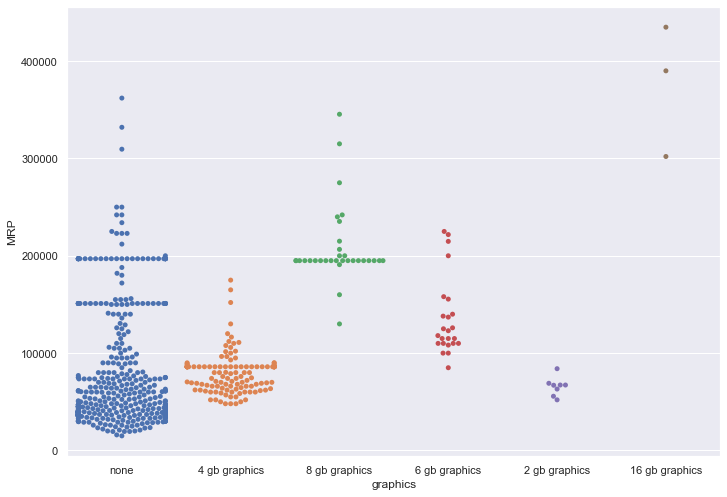

In [66]:
sns.set(rc={'figure.figsize':(11.7,8.27)})
sns.swarmplot(x="graphics", y="MRP", data=df)


<AxesSubplot:title={'center':'MRP'}, xlabel='graphics'>

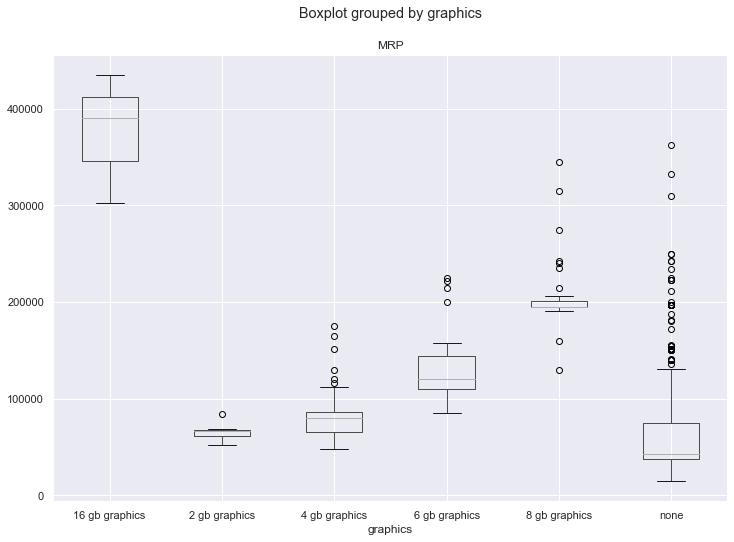

In [67]:
df.boxplot(by ='graphics', column =['MRP'], grid = True)

C:\Users\aiden\anaconda3\lib\site-packages\seaborn\categorical.py:1296: UserWarning: 43.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


<AxesSubplot:xlabel='OS', ylabel='MRP'>

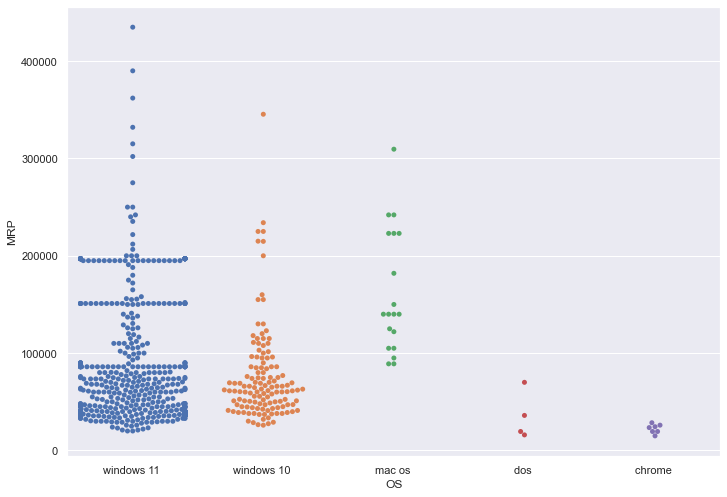

In [68]:
sns.set(rc={'figure.figsize':(11.7,8.27)})
sns.swarmplot(x="OS", y="MRP", data=df)

<AxesSubplot:title={'center':'MRP'}, xlabel='OS'>

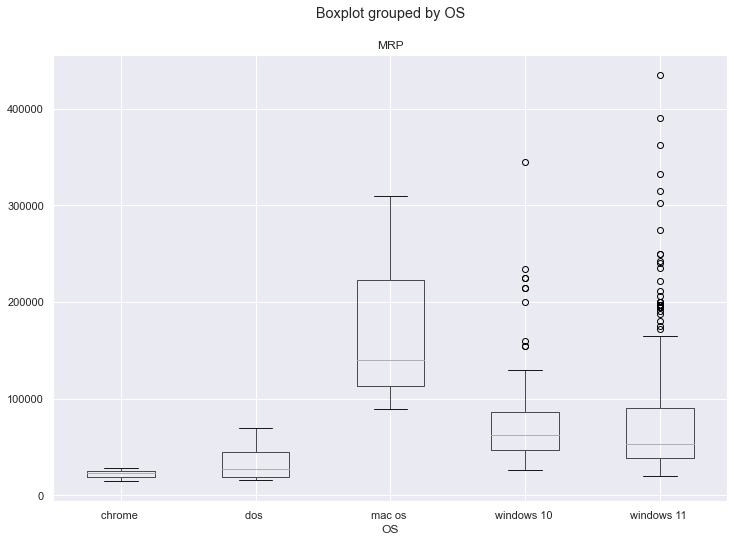

In [69]:
df.boxplot(by ='OS', column =['MRP'], grid = True)

C:\Users\aiden\anaconda3\lib\site-packages\seaborn\categorical.py:1296: UserWarning: 51.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\aiden\anaconda3\lib\site-packages\seaborn\categorical.py:1296: UserWarning: 23.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


<AxesSubplot:xlabel='ram', ylabel='MRP'>

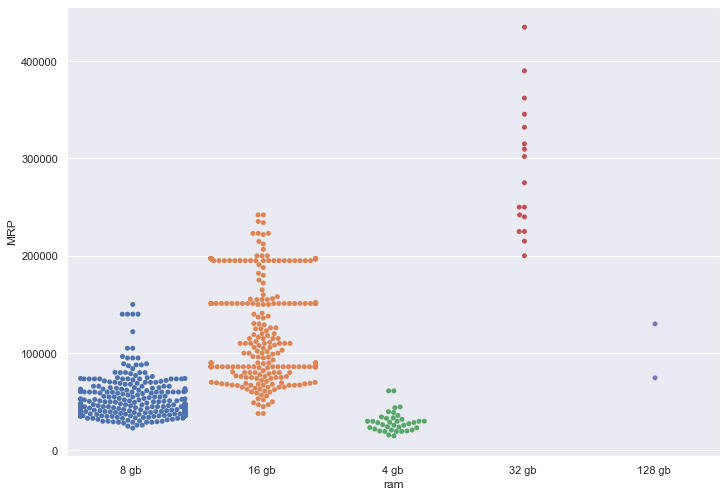

In [70]:
sns.set(rc={'figure.figsize':(11.7,8.27)})
sns.swarmplot(x="ram", y="MRP", data=df)

<AxesSubplot:title={'center':'MRP'}, xlabel='ram'>

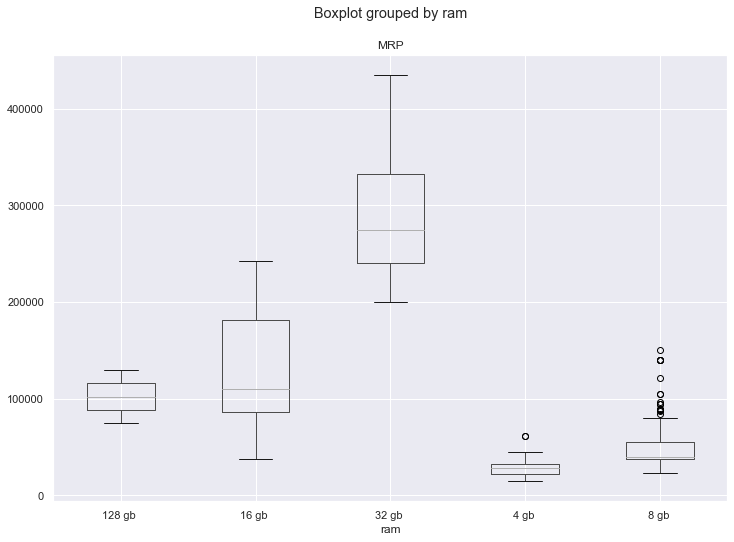

In [71]:
df.boxplot(by ='ram', column =['MRP'], grid = True)

C:\Users\aiden\anaconda3\lib\site-packages\seaborn\categorical.py:1296: UserWarning: 87.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\aiden\anaconda3\lib\site-packages\seaborn\categorical.py:1296: UserWarning: 69.6% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\aiden\anaconda3\lib\site-packages\seaborn\categorical.py:1296: UserWarning: 66.7% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\aiden\anaconda3\lib\site-packages\seaborn\categorical.py:1296: UserWarning: 41.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\aiden\anaconda3\lib\site-packages\seaborn\categorical.py:1296: UserWarning: 72.8% of the points

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46]),
 [Text(0, 0, '11th gen core i3 processor'),
  Text(1, 0, '10th gen core i3 processor'),
  Text(2, 0, 'ryzen 5 hexa core processor'),
  Text(3, 0, '10th gen core i5 processor'),
  Text(4, 0, '11th gen core i5 processor'),
  Text(5, 0, 'ryzen 7 quad core processor'),
  Text(6, 0, 'ryzen 5 quad core processor'),
  Text(7, 0, 'ryzen 9 octa core processor'),
  Text(8, 0, 'ryzen 7 octa core processor'),
  Text(9, 0, 'm1 processor'),
  Text(10, 0, 'celeron dual core processor'),
  Text(11, 0, 'ryzen 3 dual core processor'),
  Text(12, 0, '12th gen core i5 processor'),
  Text(13, 0, 'athlon dual core processor'),
  Text(14, 0, 'ryzen 3 quad core processor'),
  Text(15, 0, 'm2 processor'),
  Text(16, 0, 'celeron quad core processor'),
  Text(17, 0, '11th gen core i7 processor'),
  Tex

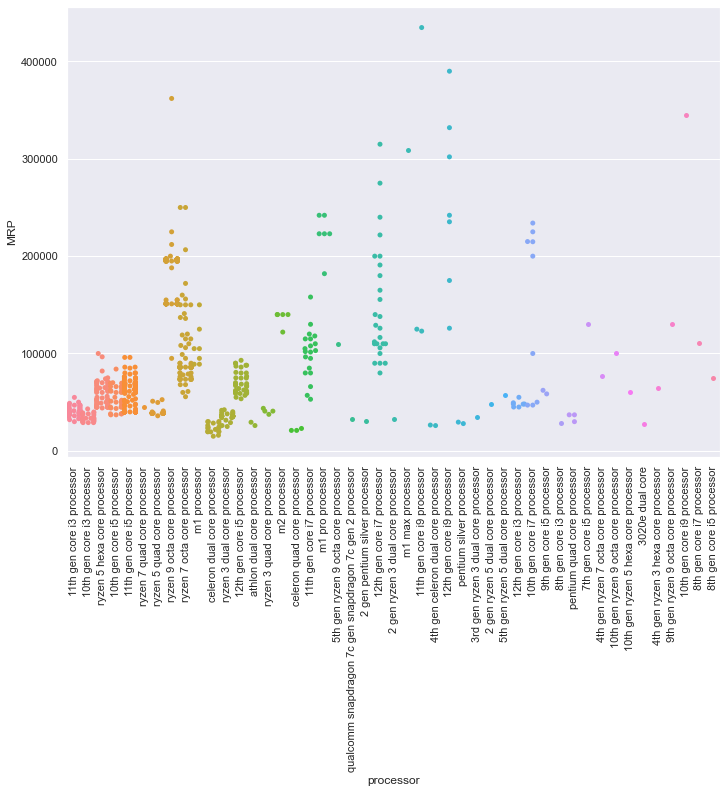

In [72]:
sns.set(rc={'figure.figsize':(11.7,8.27)})
sns.swarmplot(x="processor", y="MRP", data=df)
plt.xticks(rotation=90)

(array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34,
        35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47]),
 [Text(1, 0, '10th gen core i3 processor'),
  Text(2, 0, '10th gen core i5 processor'),
  Text(3, 0, '10th gen core i7 processor'),
  Text(4, 0, '10th gen core i9 processor'),
  Text(5, 0, '10th gen ryzen 5 hexa core processor'),
  Text(6, 0, '10th gen ryzen 9 octa core processor'),
  Text(7, 0, '11th gen core i3 processor'),
  Text(8, 0, '11th gen core i5 processor'),
  Text(9, 0, '11th gen core i7 processor'),
  Text(10, 0, '11th gen core i9 processor'),
  Text(11, 0, '12th gen core i3 processor'),
  Text(12, 0, '12th gen core i5 processor'),
  Text(13, 0, '12th gen core i7 processor'),
  Text(14, 0, '12th gen core i9 processor'),
  Text(15, 0, '2 gen pentium silver processor'),
  Text(16, 0, '2 gen ryzen 3 dual core processor'),
  Text(17, 0, '2 gen ryzen 5 dual core proce

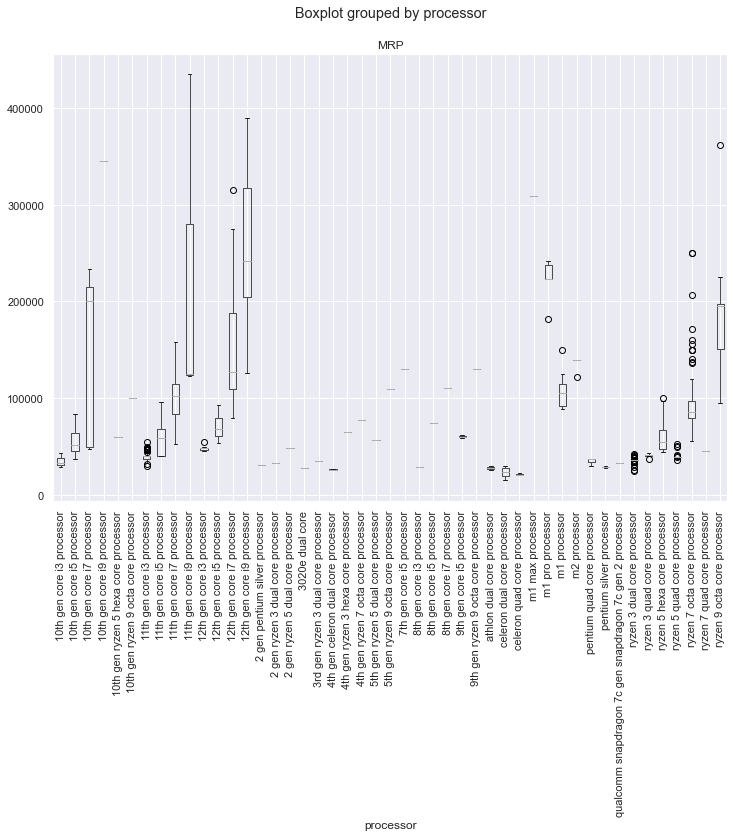

In [73]:
df.boxplot(by ='processor', column =['MRP'], grid = True)
plt.xticks(rotation=90)

In [74]:
df

,MRP,Brand,model_name,graphics,emmc type,ssd type,hdd type,processor brand,processor,ram,ram_type,OS
0,36990.0,lenovo,ideapad 3,none,none,256 gb ssd,none,intel,11th gen core i3 processor,8 gb,ddr4,windows 11
1,39990.0,lenovo,ideapad 3,none,none,512 gb ssd,none,intel,11th gen core i3 processor,8 gb,ddr4,windows 11
2,32990.0,asus,vivobook 15,none,none,512 gb ssd,none,intel,10th gen core i3 processor,8 gb,ddr4,windows 11
3,49990.0,hp,pavilion,4 gb graphics,none,512 gb ssd,none,amd,ryzen 5 hexa core processor,8 gb,ddr4,windows 10
4,49990.0,asus,tuf gaming f15,4 gb graphics,none,512 gb ssd,none,intel,10th gen core i5 processor,8 gb,ddr4,windows 11
5,36990.0,hp,14s,none,none,256 gb ssd,none,intel,11th gen core i3 processor,8 gb,ddr4,windows 11
6,38990.0,dell,inspiron,none,none,256 gb ssd,1 tb hdd,intel,11th gen core i3 processor,8 gb,ddr4,windows 11
7,39990.0,redmibook,pro,none,none,512 gb ssd,none,intel,11th gen core i5 processor,8 gb,ddr4,windows 11
8,46990.0,realme,book,none,none,256 gb ssd,none,intel,11th gen core i3 processor,8 gb,ddr4,windows 10
9,44990.0,asus,vivobook 14,none,none,512 gb ssd,none,amd,ryzen 7 quad core processor,16 gb,ddr4,windows 11


## model making


### splitting target and inpt variables

In [75]:
y=df['MRP']
x= df.drop('MRP',axis=1)

In [76]:
y

0       36990.0
1       39990.0
2       32990.0
3       49990.0
4       49990.0
5       36990.0
6       38990.0
7       39990.0
8       46990.0
9       44990.0
10      59990.0
11      38705.0
12      32990.0
13      52990.0
14      29990.0
15     196990.0
16      47990.0
17      45990.0
18      47990.0
19      85990.0
20      88990.0
21      40990.0
22      19490.0
23      35590.0
24      65990.0
25      39990.0
26      39990.0
27     196990.0
28      58990.0
29      46990.0
30      38705.0
31      85990.0
32      24990.0
33      47990.0
34      73990.0
35      53490.0
36      35590.0
37     150990.0
38      51990.0
39      66990.0
40      36990.0
41     194990.0
42      51990.0
43      25990.0
44      35990.0
45      43990.0
46      44990.0
47      64490.0
48      40990.0
49      38990.0
50      36990.0
51      39990.0
52      58990.0
53      59990.0
54      47990.0
55      37499.0
56     196990.0
57      38705.0
58      94990.0
59      32990.0
60      85990.0
61      35590.0
62      

In [77]:
x

,Brand,model_name,graphics,emmc type,ssd type,hdd type,processor brand,processor,ram,ram_type,OS
0,lenovo,ideapad 3,none,none,256 gb ssd,none,intel,11th gen core i3 processor,8 gb,ddr4,windows 11
1,lenovo,ideapad 3,none,none,512 gb ssd,none,intel,11th gen core i3 processor,8 gb,ddr4,windows 11
2,asus,vivobook 15,none,none,512 gb ssd,none,intel,10th gen core i3 processor,8 gb,ddr4,windows 11
3,hp,pavilion,4 gb graphics,none,512 gb ssd,none,amd,ryzen 5 hexa core processor,8 gb,ddr4,windows 10
4,asus,tuf gaming f15,4 gb graphics,none,512 gb ssd,none,intel,10th gen core i5 processor,8 gb,ddr4,windows 11
5,hp,14s,none,none,256 gb ssd,none,intel,11th gen core i3 processor,8 gb,ddr4,windows 11
6,dell,inspiron,none,none,256 gb ssd,1 tb hdd,intel,11th gen core i3 processor,8 gb,ddr4,windows 11
7,redmibook,pro,none,none,512 gb ssd,none,intel,11th gen core i5 processor,8 gb,ddr4,windows 11
8,realme,book,none,none,256 gb ssd,none,intel,11th gen core i3 processor,8 gb,ddr4,windows 10
9,asus,vivobook 14,none,none,512 gb ssd,none,amd,ryzen 7 quad core processor,16 gb,ddr4,windows 11


In [78]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(x, y, train_size=0.60, random_state=100)

In [79]:
x_train

,Brand,model_name,graphics,emmc type,ssd type,hdd type,processor brand,processor,ram,ram_type,OS
27,asus,rog strix g15,none,none,1 tb ssd,none,amd,ryzen 9 octa core processor,16 gb,ddr5,windows 11
554,hp,laptop,none,none,512 gb ssd,none,intel,11th gen core i3 processor,8 gb,ddr4,windows 11
96,lenovo,ideapad 3 cb,none,64 gb emmc,none,none,intel,celeron dual core processor,4 gb,ddr4,chrome
5,hp,14s,none,none,256 gb ssd,none,intel,11th gen core i3 processor,8 gb,ddr4,windows 11
270,lenovo,ideapad 1,none,none,512 gb ssd,none,amd,ryzen 5 quad core processor,8 gb,ddr4,windows 11
199,asus,vivobook 15,none,none,none,1 tb hdd,intel,10th gen core i3 processor,8 gb,ddr4,windows 10
462,hp,victus,6 gb graphics,none,1 tb ssd,none,amd,ryzen 7 octa core processor,16 gb,ddr4,windows 11
177,asus,rog strix g15,none,none,1 tb ssd,none,amd,ryzen 9 octa core processor,16 gb,ddr5,windows 11
166,asus,rog zephyrus g15,8 gb graphics,none,1 tb ssd,none,amd,ryzen 9 octa core processor,16 gb,ddr5,windows 11
393,acer,aspire 5,none,none,none,1 tb hdd,intel,11th gen core i5 processor,8 gb,ddr4,windows 10


In [80]:
from sklearn.preprocessing import OneHotEncoder

encoder_ = OneHotEncoder(drop='first', sparse=False,handle_unknown = "ignore")

x_train_ohe = pd.DataFrame(encoder_.fit_transform(x_train), 
                               columns=encoder_.get_feature_names_out(x_train.columns), 
                               index = x_train.index)

x_train_ohe

C:\Users\aiden\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:808: FutureWarning: `sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.
  warnings.warn(


,Brand_alienware,Brand_apple,Brand_asus,Brand_dell,Brand_hp,Brand_infinix,Brand_lenovo,Brand_msi,Brand_realme,Brand_redmibook,Brand_samsung,Brand_ultimus,Brand_vaio,model_name_15s,model_name_2020 macbook air,model_name_2021 macbook pro,model_name_2022 macbook air,model_name_2022 macbook pro,model_name_allienware,model_name_alpha 15,model_name_aspire,model_name_aspire 3,model_name_aspire 5,model_name_aspire 7,model_name_aspire vero,model_name_aspire vero,model_name_asus tuf dash,model_name_athlon,model_name_book,model_name_book,model_name_bravo 15,model_name_chromebook,model_name_chromebook flip touch,model_name_creator 15,model_name_delta 15,model_name_e series,model_name_eeebook 12,model_name_envy x360,model_name_expertbook,model_name_expertbook b9,model_name_expertbook p1,model_name_expertbook p2,model_name_extensa,model_name_g15,model_name_g8,model_name_galaxy book go,model_name_galaxy book2,model_name_gf63 thin,model_name_gp66 leopard,model_name_ideapad,model_name_ideapad 1,model_name_ideapad 3,model_name_ideapad 3 cb,model_name_ideapad 5,model_name_ideapad 5 pro,model_name_ideapad gaming,model_name_ideapad gaming 3,model_name_ideapad slim 3,model_name_ideapad slim 3i,model_name_ideapad slim 5,model_name_inbook x1,model_name_inbook x1 neo series,model_name_inbook x2 plus,model_name_inspiron,model_name_katana gf66,model_name_laptop,model_name_legion 5,model_name_modern 14,model_name_nitro 5,model_name_none,model_name_omen,model_name_pavilion,model_name_pavilion gaming,model_name_predator helios 300,model_name_pro,model_name_pulse gl66,model_name_rog flow x13,model_name_rog flow x16,model_name_rog flow z13,model_name_rog strix g15,model_name_rog strix scar 15,model_name_rog zephyrus,model_name_rog zephyrus duo 16,model_name_rog zephyrus g14,model_name_rog zephyrus g15,model_name_s151,model_name_spectre,model_name_stealth gs66,model_name_stealth gs77,model_name_studiobook pro,model_name_sword 15,model_name_thinkpad,model_name_tuf gaming a15,model_name_tuf gaming a17,model_name_tuf gaming f15,model_name_tuf gaming f17,model_name_vector gp66,model_name_victus,model_name_vivobook,model_name_vivobook 14,model_name_vivobook 15,model_name_vivobook flip 14,model_name_vivobook k15 oled,model_name_vivobook pro 15,model_name_vivobook pro 15 oled,model_name_vivobook s14 oled,model_name_vivobook ultra 14,model_name_vostro,model_name_x1 series,model_name_x1 slim series,model_name_yoga 6,model_name_yoga slim 7,model_name_zenbook 13,model_name_zenbook duo 14,model_name_zenbook pro 15,model_name_zenbook s 13 oled,graphics_2 gb graphics,graphics_4 gb graphics,graphics_6 gb graphics,graphics_8 gb graphics,graphics_none,emmc type_64 gb emmc,emmc type_none,ssd type_128 gb ssd,ssd type_2 tb ssd,ssd type_256 gb ssd,ssd type_512 gb ssd,ssd type_none,hdd type_none,processor brand_apple,processor brand_intel,processor brand_qualcomm,processor_10th gen core i5 processor,processor_10th gen core i7 processor,processor_10th gen ryzen 5 hexa core processor,processor_11th gen core i3 processor,processor_11th gen core i5 processor,processor_11th gen core i7 processor,processor_11th gen core i9 processor,processor_12th gen core i3 processor,processor_12th gen core i5 processor,processor_12th gen core i7 processor,processor_12th gen core i9 processor,processor_2 gen pentium silver processor,processor_3020e dual core,processor_4th gen celeron dual core processor,processor_4th gen ryzen 3 hexa core processor,processor_4th gen ryzen 7 octa core processor,processor_5th gen ryzen 5 dual core processor,processor_5th gen ryzen 9 octa core processor,processor_7th gen core i5 processor,processor_8th gen core i3 processor,processor_8th gen core i5 processor,processor_8th gen core i7 processor,processor_9th gen core i5 processor,processor_athlon dual core processor,processor_celeron dual core processor,processor_celeron quad core processor,processor_m1 pro processor,processor_m1 processor,processor_m2 processor,processor_pentium quad core processor,processor_pentium sil

In [81]:
x_test

,Brand,model_name,graphics,emmc type,ssd type,hdd type,processor brand,processor,ram,ram_type,OS
198,acer,aspire 3,none,none,512 gb ssd,none,amd,ryzen 5 quad core processor,8 gb,ddr4,windows 10
487,lenovo,ideapad 1,none,none,512 gb ssd,none,amd,ryzen 5 quad core processor,8 gb,ddr4,windows 11
365,hp,omen,none,none,1 tb ssd,none,amd,ryzen 7 octa core processor,16 gb,ddr4,windows 11
620,lenovo,ideapad gaming 3,none,none,512 gb ssd,none,amd,ryzen 7 octa core processor,8 gb,ddr4,windows 11
636,lenovo,ideapad 1,none,none,512 gb ssd,none,amd,ryzen 5 quad core processor,8 gb,ddr4,windows 11
396,dell,vostro,none,none,512 gb ssd,none,amd,ryzen 5 quad core processor,8 gb,ddr4,windows 10
193,asus,tuf gaming f15,6 gb graphics,none,1 tb ssd,none,intel,11th gen core i9 processor,16 gb,ddr4,windows 10
432,dell,inspiron,none,none,512 gb ssd,none,amd,ryzen 5 quad core processor,8 gb,ddr4,windows 11
540,lenovo,ideapad 1,none,none,512 gb ssd,none,amd,ryzen 3 dual core processor,8 gb,ddr4,windows 11
195,acer,aspire 7,4 gb graphics,none,512 gb ssd,none,intel,12th gen core i5 processor,8 gb,ddr4,windows 11


In [82]:
x_test_ohe = pd.DataFrame(encoder_.transform(x_test), 
                               columns=encoder_.get_feature_names_out(x_test.columns), 
                               index = x_test.index)

x_test_ohe

C:\Users\aiden\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:182: UserWarning: Found unknown categories in columns [0, 1, 3, 5, 7] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


,Brand_alienware,Brand_apple,Brand_asus,Brand_dell,Brand_hp,Brand_infinix,Brand_lenovo,Brand_msi,Brand_realme,Brand_redmibook,Brand_samsung,Brand_ultimus,Brand_vaio,model_name_15s,model_name_2020 macbook air,model_name_2021 macbook pro,model_name_2022 macbook air,model_name_2022 macbook pro,model_name_allienware,model_name_alpha 15,model_name_aspire,model_name_aspire 3,model_name_aspire 5,model_name_aspire 7,model_name_aspire vero,model_name_aspire vero,model_name_asus tuf dash,model_name_athlon,model_name_book,model_name_book,model_name_bravo 15,model_name_chromebook,model_name_chromebook flip touch,model_name_creator 15,model_name_delta 15,model_name_e series,model_name_eeebook 12,model_name_envy x360,model_name_expertbook,model_name_expertbook b9,model_name_expertbook p1,model_name_expertbook p2,model_name_extensa,model_name_g15,model_name_g8,model_name_galaxy book go,model_name_galaxy book2,model_name_gf63 thin,model_name_gp66 leopard,model_name_ideapad,model_name_ideapad 1,model_name_ideapad 3,model_name_ideapad 3 cb,model_name_ideapad 5,model_name_ideapad 5 pro,model_name_ideapad gaming,model_name_ideapad gaming 3,model_name_ideapad slim 3,model_name_ideapad slim 3i,model_name_ideapad slim 5,model_name_inbook x1,model_name_inbook x1 neo series,model_name_inbook x2 plus,model_name_inspiron,model_name_katana gf66,model_name_laptop,model_name_legion 5,model_name_modern 14,model_name_nitro 5,model_name_none,model_name_omen,model_name_pavilion,model_name_pavilion gaming,model_name_predator helios 300,model_name_pro,model_name_pulse gl66,model_name_rog flow x13,model_name_rog flow x16,model_name_rog flow z13,model_name_rog strix g15,model_name_rog strix scar 15,model_name_rog zephyrus,model_name_rog zephyrus duo 16,model_name_rog zephyrus g14,model_name_rog zephyrus g15,model_name_s151,model_name_spectre,model_name_stealth gs66,model_name_stealth gs77,model_name_studiobook pro,model_name_sword 15,model_name_thinkpad,model_name_tuf gaming a15,model_name_tuf gaming a17,model_name_tuf gaming f15,model_name_tuf gaming f17,model_name_vector gp66,model_name_victus,model_name_vivobook,model_name_vivobook 14,model_name_vivobook 15,model_name_vivobook flip 14,model_name_vivobook k15 oled,model_name_vivobook pro 15,model_name_vivobook pro 15 oled,model_name_vivobook s14 oled,model_name_vivobook ultra 14,model_name_vostro,model_name_x1 series,model_name_x1 slim series,model_name_yoga 6,model_name_yoga slim 7,model_name_zenbook 13,model_name_zenbook duo 14,model_name_zenbook pro 15,model_name_zenbook s 13 oled,graphics_2 gb graphics,graphics_4 gb graphics,graphics_6 gb graphics,graphics_8 gb graphics,graphics_none,emmc type_64 gb emmc,emmc type_none,ssd type_128 gb ssd,ssd type_2 tb ssd,ssd type_256 gb ssd,ssd type_512 gb ssd,ssd type_none,hdd type_none,processor brand_apple,processor brand_intel,processor brand_qualcomm,processor_10th gen core i5 processor,processor_10th gen core i7 processor,processor_10th gen ryzen 5 hexa core processor,processor_11th gen core i3 processor,processor_11th gen core i5 processor,processor_11th gen core i7 processor,processor_11th gen core i9 processor,processor_12th gen core i3 processor,processor_12th gen core i5 processor,processor_12th gen core i7 processor,processor_12th gen core i9 processor,processor_2 gen pentium silver processor,processor_3020e dual core,processor_4th gen celeron dual core processor,processor_4th gen ryzen 3 hexa core processor,processor_4th gen ryzen 7 octa core processor,processor_5th gen ryzen 5 dual core processor,processor_5th gen ryzen 9 octa core processor,processor_7th gen core i5 processor,processor_8th gen core i3 processor,processor_8th gen core i5 processor,processor_8th gen core i7 processor,processor_9th gen core i5 processor,processor_athlon dual core processor,processor_celeron dual core processor,processor_celeron quad core processor,processor_m1 pro processor,processor_m1 processor,processor_m2 processor,processor_pentium quad core processor,processor_pentium sil

## training model



## random forest regressor

In [83]:
from sklearn.ensemble import RandomForestRegressor
Modellr = RandomForestRegressor()
Modellr.fit(x_train_ohe, y_train)

RandomForestRegressor()

In [84]:
y_test_pred=Modellr.predict(x_test_ohe)
y_test_pred

array([ 40677.45      ,  38705.        , 103889.89      ,  73490.        ,
        38705.        ,  44511.16      , 122241.        ,  42635.745     ,
        35590.        ,  55067.05666667,  38705.        ,  73890.37333333,
        39990.        ,  43525.5       , 196990.        ,  61665.        ,
        43580.44782609,  37018.22995983,  42861.36740787,  42619.32      ,
        47461.76904762, 110329.        ,  39990.        ,  85990.        ,
       196990.        , 127655.        ,  35590.        , 120686.95666667,
        44008.75190476,  39990.        ,  57951.        ,  38705.        ,
        85990.        ,  93251.6       , 196990.        ,  54311.3       ,
        42039.93666667,  38705.        ,  65696.978     , 153097.38790382,
        55984.27466667,  39399.90674104, 153097.38790382, 111993.8       ,
        64644.82666667,  39990.        ,  50803.4       ,  41547.32      ,
        39990.        , 194990.        ,  74303.48666667,  73828.34      ,
       153097.38790382,  

In [85]:
result=pd.DataFrame({'actual':y_test,'predicted':y_test_pred})
result

,actual,predicted
198,39990.0,40677.450000
487,38705.0,38705.000000
365,118990.0,103889.890000
620,73490.0,73490.000000
636,38705.0,38705.000000
396,49690.0,44511.160000
193,122990.0,122241.000000
432,50990.0,42635.745000
540,35590.0,35590.000000
195,59990.0,55067.056667


<AxesSubplot:xlabel='MRP', ylabel='Count'>

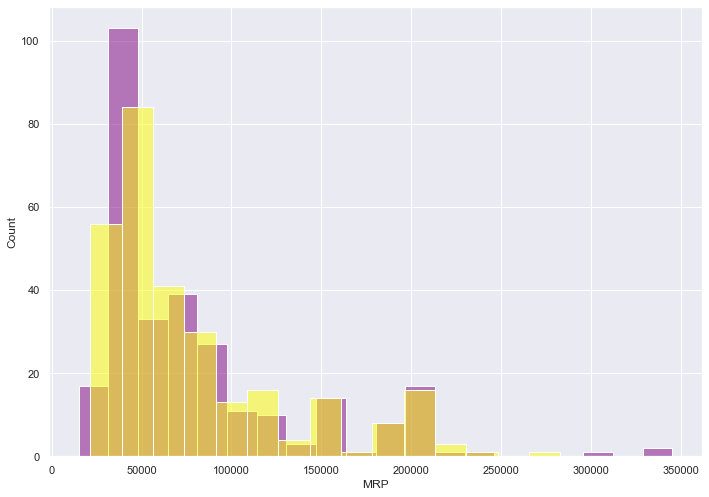

In [86]:
sns.histplot(y_test, color='purple', alpha=0.5)
sns.histplot(y_test_pred, color='yellow', alpha=0.5)

In [87]:
from sklearn import metrics

print('Mean Absolute Error: ', metrics.mean_absolute_error(y_test, y_test_pred))

print('Mean Squared Error: ', metrics.mean_squared_error(y_test, y_test_pred))

print('Root Mean Squared Error: ', np.sqrt(metrics.mean_squared_error(y_test, y_test_pred)))

Mean Absolute Error:  6456.982081230993
Mean Squared Error:  202091670.22449002
Root Mean Squared Error:  14215.894984997954


## GBDT



In [88]:
from sklearn.ensemble import GradientBoostingClassifier
Modellgbt = GradientBoostingClassifier()
Modellgbt.fit(x_train_ohe, y_train)

GradientBoostingClassifier()

In [89]:
y_test_pred=Modellgbt.predict(x_test_ohe)
y_test_pred

array([ 24990.,  38705.,  70400.,  73490.,  38705.,  43090.,  59990.,
        39990.,  35590.,  54990.,  38705.,  89990.,  39990.,  40990.,
       196990.,  56990.,  36990.,  36990.,  36990.,  39990.,  49990.,
       241990.,  39990.,  85990., 196990., 105990.,  35590.,  40190.,
        46990.,  39990.,  62190.,  38705.,  85990.,  94990., 196990.,
        49990.,  42690.,  38705.,  80249., 150990.,  59990.,  36990.,
       150990.,  60990.,  59990.,  39990.,  49990.,  36990.,  39990.,
       194990.,  80249.,  94990., 150990.,  36990.,  39990.,  39990.,
        85990., 139990., 224990.,  49990.,  43990.,  37990., 194990.,
        38705., 194990.,  39990.,  80249.,  49990., 196990.,  35590.,
        29990.,  38990.,  39990.,  39990.,  36990.,  35590.,  71990.,
       194990.,  63090.,  39990.,  39990.,  39990.,  85990.,  44990.,
        31990.,  39990.,  36990.,  35590.,  36990., 196990.,  43990.,
        35590.,  29490.,  39990., 116490.,  54990.,  80249., 150990.,
        85990.,  389

In [90]:
result=pd.DataFrame({'actual':y_test,'predicted':y_test_pred})
result

,actual,predicted
198,39990.0,24990.0
487,38705.0,38705.0
365,118990.0,70400.0
620,73490.0,73490.0
636,38705.0,38705.0
396,49690.0,43090.0
193,122990.0,59990.0
432,50990.0,39990.0
540,35590.0,35590.0
195,59990.0,54990.0


<AxesSubplot:xlabel='MRP', ylabel='Count'>

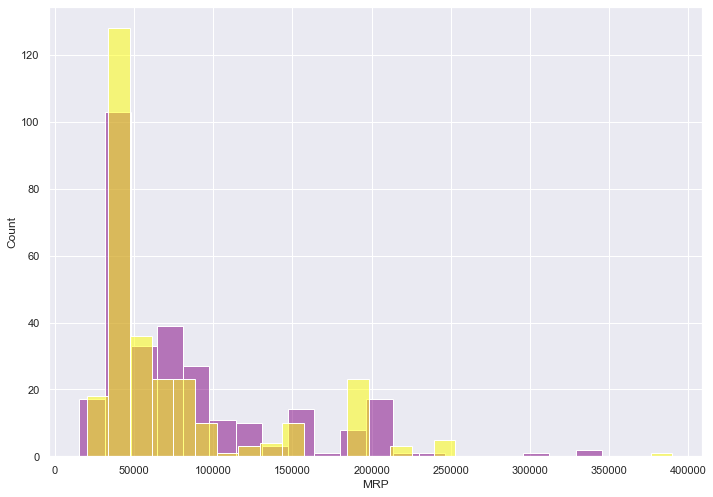

In [91]:
sns.histplot(y_test, color='purple', alpha=0.5)
sns.histplot(y_test_pred, color='yellow', alpha=0.5)

In [92]:
from sklearn import metrics

print('Mean Absolute Error: ', metrics.mean_absolute_error(y_test, y_test_pred))

print('Mean Squared Error: ', metrics.mean_squared_error(y_test, y_test_pred))

print('Root Mean Squared Error: ', np.sqrt(metrics.mean_squared_error(y_test, y_test_pred)))

Mean Absolute Error:  14237.260416666666
Mean Squared Error:  1173423732.09375
Root Mean Squared Error:  34255.27305530858


In [109]:
import joblib as jl
import pickle as pkl

In [111]:
jl.dump(Modellr,'laptop_predict_model')

['laptop_predict_model']

In [116]:
jl.dump(encoder_,'encoder.pkl')

['encoder.pkl']

AttributeError: module 'pandas' has no attribute 'Dataframe'

In [94]:
column_names = [
    "Brand_alienware", "Brand_apple", "Brand_asus", "Brand_dell", "Brand_hp", "Brand_infinix", "Brand_lenovo", 
    "Brand_msi", "Brand_realme", "Brand_redmibook", "Brand_samsung", "Brand_ultimus", "Brand_vaio",
    "model_name_15s", "model_name_2020 macbook air", "model_name_2021 macbook pro", "model_name_2022 macbook air",
    "model_name_2022 macbook pro", "model_name_allienware", "model_name_alpha 15", "model_name_aspire", 
    "model_name_aspire 3", "model_name_aspire 5", "model_name_aspire 7", "model_name_aspire vero", 
    "model_name_asus tuf dash", "model_name_athlon", "model_name_book", "model_name_bravo 15", 
    "model_name_chromebook", "model_name_chromebook flip touch", "model_name_creator 15", "model_name_delta 15", 
    "model_name_e series", "model_name_eeebook 12", "model_name_envy x360", "model_name_expertbook", 
    "model_name_expertbook b9", "model_name_expertbook p1", "model_name_expertbook p2", "model_name_extensa", 
    "model_name_g15", "model_name_g8", "model_name_galaxy book go", "model_name_galaxy book2", "model_name_gf63 thin", 
    "model_name_gp66 leopard", "model_name_ideapad", "model_name_ideapad 1", "model_name_ideapad 3", 
    "model_name_ideapad 3 cb", "model_name_ideapad 5", "model_name_ideapad 5 pro", "model_name_ideapad gaming", 
    "model_name_ideapad gaming 3", "model_name_ideapad slim 3", "model_name_ideapad slim 3i", 
    "model_name_ideapad slim 5", "model_name_inbook x1", "model_name_inbook x1 neo series", 
    "model_name_inbook x2 plus", "model_name_inspiron", "model_name_katana gf66", "model_name_laptop", 
    "model_name_legion 5", "model_name_modern 14", "model_name_nitro 5", "model_name_none", "model_name_omen", 
    "model_name_pavilion", "model_name_pavilion gaming", "model_name_predator helios 300", "model_name_pro", 
    "model_name_pulse gl66", "model_name_rog flow x13", "model_name_rog flow x16", "model_name_rog flow z13", 
    "model_name_rog strix g15", "model_name_rog strix scar 15", "model_name_rog zephyrus", 
    "model_name_rog zephyrus duo 16", "model_name_rog zephyrus g14", "model_name_rog zephyrus g15", 
    "model_name_s151", "model_name_spectre", "model_name_stealth gs66", "model_name_stealth gs77", 
    "model_name_studiobook pro", "model_name_sword 15", "model_name_thinkpad", "model_name_tuf gaming a15", 
    "model_name_tuf gaming a17", "model_name_tuf gaming f15", "model_name_tuf gaming f17", "model_name_vector gp66", 
    "model_name_victus", "model_name_vivobook", "model_name_vivobook 14", "model_name_vivobook 15", 
    "model_name_vivobook flip 14", "model_name_vivobook k15 oled", "model_name_vivobook pro 15", 
    "model_name_vivobook pro 15 oled", "model_name_vivobook s14 oled", "model_name_vivobook ultra 14", 
    "model_name_vostro", "model_name_x1 series", "model_name_x1 slim series", "model_name_yoga 6", 
    "model_name_yoga slim 7", "model_name_zenbook 13", "model_name_zenbook duo 14", "model_name_zenbook pro 15", 
    "model_name_zenbook s 13 oled", "graphics_2 gb graphics", "graphics_4 gb graphics", 
    "graphics_6 gb graphics", "graphics_8 gb graphics", "graphics_none", "emmc type_64 gb emmc", 
    "emmc type_none", "ssd type_128 gb ssd", "ssd type_2 tb ssd", "ssd type_256 gb ssd", "ssd type_512 gb ssd", 
    "ssd type_none", "hdd type_none", "processor brand_apple", "processor brand_intel", 
    "processor brand_qualcomm", "processor_10th gen core i5 processor", "processor_10th gen core i7 processor", 
    "processor_10th gen ryzen 5 hexa core processor", "processor_11th gen core i3 processor", 
    "processor_11th gen core i5 processor", "processor_11th gen core i7 processor", 
    "processor_11th gen core i9 processor", "processor_12th gen core i3 processor", 
    "processor_12th gen core i5 processor", "processor_12th gen core i7 processor", 
    "processor_12th gen core i9 processor", "processor_2 gen pentium silver processor", 
    "processor_3020e dual core", "processor_4th gen celeron dual core processor", 
    "processor_4th gen ryzen 3 hexa core processor", "processor_4th gen ryzen 7 octa core processor", 
    "processor_5th gen ryzen 5 dual core processor", "processor_5th gen ryzen 9 octa core processor", 
    "processor_7th gen core i5 processor", "processor_8th gen core i3 processor", "processor_8th gen core i5 processor", 
    "processor_8th gen core i7 processor", "processor_9th gen core i5 processor", "processor_athlon dual core processor", 
    "processor_celeron dual core processor", "processor_celeron quad core processor", "processor_m1 pro processor", 
    "processor_m1 processor", "processor_m2 processor", "processor_pentium quad core processor", 
    "processor_pentium silver processor", "processor_qualcomm snapdragon 7c gen snapdragon 7c gen 2 processor", 
    "processor_ryzen 3 dual core processor", "processor_ryzen 3 quad core processor", 
    "processor_ryzen 5 hexa core processor", "processor_ryzen 5 quad core processor", "processor_ryzen 7 octa core processor", 
    "processor_ryzen 9 octa core processor", "ram_16 gb", "ram_32 gb", "ram_4 gb", "ram_8 gb", "ram_type_ddr5", 
    "ram_type_lpddr3", "ram_type_lpddr4", "ram_type_lpddr4x", "ram_type_lpddr5", "ram_type_unified memory", 
    "OS_dos", "OS_mac os", "OS_windows 10", "OS_windows 11"
]


Index(['MRP', 'Brand', 'model_name', 'graphics', 'emmc type', 'ssd type',
       'hdd type', 'processor brand', 'processor', 'ram', 'ram_type', 'OS'],
      dtype='object')

In [96]:
Brand_alienware	Brand_apple	Brand_asus	Brand_dell	Brand_hp	Brand_infinix	Brand_lenovo	Brand_msi	Brand_realme	Brand_redmibook	Brand_samsung	Brand_ultimus	Brand_vaio	model_name_15s	model_name_2020 macbook air	model_name_2021 macbook pro	model_name_2022 macbook air	model_name_2022 macbook pro	model_name_allienware	model_name_alpha 15	model_name_aspire	model_name_aspire 3	model_name_aspire 5	model_name_aspire 7	model_name_aspire vero	model_name_aspire vero	model_name_asus tuf dash	model_name_athlon	model_name_book	model_name_book	model_name_bravo 15	model_name_chromebook	model_name_chromebook flip touch	model_name_creator 15	model_name_delta 15	model_name_e series	model_name_eeebook 12	model_name_envy x360	model_name_expertbook	model_name_expertbook b9	model_name_expertbook p1	model_name_expertbook p2	model_name_extensa	model_name_g15	model_name_g8	model_name_galaxy book go	model_name_galaxy book2	model_name_gf63 thin	model_name_gp66 leopard	model_name_ideapad	model_name_ideapad 1	model_name_ideapad 3	model_name_ideapad 3 cb	model_name_ideapad 5	model_name_ideapad 5 pro	model_name_ideapad gaming	model_name_ideapad gaming 3	model_name_ideapad slim 3	model_name_ideapad slim 3i	model_name_ideapad slim 5	model_name_inbook x1	model_name_inbook x1 neo series	model_name_inbook x2 plus	model_name_inspiron	model_name_katana gf66	model_name_laptop	model_name_legion 5	model_name_modern 14	model_name_nitro 5	model_name_none	model_name_omen	model_name_pavilion	model_name_pavilion gaming	model_name_predator helios 300	model_name_pro	model_name_pulse gl66	model_name_rog flow x13	model_name_rog flow x16	model_name_rog flow z13	model_name_rog strix g15	model_name_rog strix scar 15	model_name_rog zephyrus	model_name_rog zephyrus duo 16	model_name_rog zephyrus g14	model_name_rog zephyrus g15	model_name_s151	model_name_spectre	model_name_stealth gs66	model_name_stealth gs77	model_name_studiobook pro	model_name_sword 15	model_name_thinkpad	model_name_tuf gaming a15	model_name_tuf gaming a17	model_name_tuf gaming f15	model_name_tuf gaming f17	model_name_vector gp66	model_name_victus	model_name_vivobook	model_name_vivobook 14	model_name_vivobook 15	model_name_vivobook flip 14	model_name_vivobook k15 oled	model_name_vivobook pro 15	model_name_vivobook pro 15 oled	model_name_vivobook s14 oled	model_name_vivobook ultra 14	model_name_vostro	model_name_x1 series	model_name_x1 slim series	model_name_yoga 6	model_name_yoga slim 7	model_name_zenbook 13	model_name_zenbook duo 14	model_name_zenbook pro 15	model_name_zenbook s 13 oled	graphics_2 gb graphics	graphics_4 gb graphics	graphics_6 gb graphics	graphics_8 gb graphics	graphics_none	emmc type_64 gb emmc	emmc type_none	ssd type_128 gb ssd	ssd type_2 tb ssd	ssd type_256 gb ssd	ssd type_512 gb ssd	ssd type_none	hdd type_none	processor brand_apple	processor brand_intel	processor brand_qualcomm	processor_10th gen core i5 processor	processor_10th gen core i7 processor	processor_10th gen ryzen 5 hexa core processor	processor_11th gen core i3 processor	processor_11th gen core i5 processor	processor_11th gen core i7 processor	processor_11th gen core i9 processor	processor_12th gen core i3 processor	processor_12th gen core i5 processor	processor_12th gen core i7 processor	processor_12th gen core i9 processor	processor_2 gen pentium silver processor	processor_3020e dual core	processor_4th gen celeron dual core processor	processor_4th gen ryzen 3 hexa core processor	processor_4th gen ryzen 7 octa core processor	processor_5th gen ryzen 5 dual core processor	processor_5th gen ryzen 9 octa core processor	processor_7th gen core i5 processor	processor_8th gen core i3 processor	processor_8th gen core i5 processor	processor_8th gen core i7 processor	processor_9th gen core i5 processor	processor_athlon dual core processor	processor_celeron dual core processor	processor_celeron quad core processor	processor_m1 pro processor	processor_m1 processor	processor_m2 processor	processor_pentium quad core processor	processor_pentium silver processor	processor_qualcomm snapdragon 7c gen snapdragon 7c gen 2 processor	processor_ryzen 3 dual core processor	processor_ryzen 3 quad core processor	processor_ryzen 5 hexa core processor	processor_ryzen 5 quad core processor	processor_ryzen 7 octa core processor	processor_ryzen 9 octa core processor	ram_16 gb	ram_32 gb	ram_4 gb	ram_8 gb	ram_type_ddr5	ram_type_lpddr3	ram_type_lpddr4	ram_type_lpddr4x	ram_type_lpddr5	ram_type_unified memory	OS_dos	OS_mac os	OS_windows 10	OS_windows 11

Brand_alienware	Brand_apple	Brand_asus	Brand_dell	Brand_hp	Brand_infinix	Brand_lenovo	Brand_msi	Brand_realme	Brand_redmibook	Brand_samsung	Brand_ultimus	Brand_vaio	model_name_15s	model_name_2020 macbook air	model_name_2021 macbook pro	model_name_2022 macbook air	model_name_2022 macbook pro	model_name_allienware	model_name_alpha 15	model_name_aspire	model_name_aspire 3	model_name_aspire 5	model_name_aspire 7	model_name_aspire vero	model_name_aspire vero	model_name_asus tuf dash	model_name_athlon	model_name_book	model_name_book	model_name_bravo 15	model_name_chromebook	model_name_chromebook flip touch	model_name_creator 15	model_name_delta 15	model_name_e series	model_name_eeebook 12	model_name_envy x360	model_name_expertbook	model_name_expertbook b9	model_name_expertbook p1	model_name_expertbook p2	model_name_extensa	model_name_g15	model_name_g8	model_name_galaxy book go	model_name_galaxy book2	model_name_gf63 thin	model_name_gp66 leopard	model_name_ideapad	model_name_ideapad 1	model_name_ideapad 3	model_name_ideapad 3 cb	model_name_ideapad 5	model_name_ideapad 5 pro	model_name_ideapad gaming	model_name_ideapad gaming 3	model_name_ideapad slim 3	model_name_ideapad slim 3i	model_name_ideapad slim 5	model_name_inbook x1	model_name_inbook x1 neo series	model_name_inbook x2 plus	model_name_inspiron	model_name_katana gf66	model_name_laptop	model_name_legion 5	model_name_modern 14	model_name_nitro 5	model_name_none	model_name_omen	model_name_pavilion	model_name_pavilion gaming	model_name_predator helios 300	model_name_pro	model_name_pulse gl66	model_name_rog flow x13	model_name_rog flow x16	model_name_rog flow z13	model_name_rog strix g15	model_name_rog strix scar 15	model_name_rog zephyrus	model_name_rog zephyrus duo 16	model_name_rog zephyrus g14	model_name_rog zephyrus g15	model_name_s151	model_name_spectre	model_name_stealth gs66	model_name_stealth gs77	model_name_studiobook pro	model_name_sword 15	model_name_thinkpad	model_name_tuf gaming a15	model_name_tuf gaming a17	model_name_tuf gaming f15	model_name_tuf gaming f17	model_name_vector gp66	model_name_victus	model_name_vivobook	model_name_vivobook 14	model_name_vivobook 15	model_name_vivobook flip 14	model_name_vivobook k15 oled	model_name_vivobook pro 15	model_name_vivobook pro 15 oled	model_name_vivobook s14 oled	model_name_vivobook ultra 14	model_name_vostro	model_name_x1 series	model_name_x1 slim series	model_name_yoga 6	model_name_yoga slim 7	model_name_zenbook 13	model_name_zenbook duo 14	model_name_zenbook pro 15	model_name_zenbook s 13 oled	graphics_2 gb graphics	graphics_4 gb graphics	graphics_6 gb graphics	graphics_8 gb graphics	graphics_none	emmc type_64 gb emmc	emmc type_none	ssd type_128 gb ssd	ssd type_2 tb ssd	ssd type_256 gb ssd	ssd type_512 gb ssd	ssd type_none	hdd type_none	processor brand_apple	processor brand_intel	processor brand_qualcomm	processor_10th gen core i5 processor	processor_10th gen core i7 processor	processor_10th gen ryzen 5 hexa core processor	processor_11th gen core i3 processor	processor_11th gen core i5 processor	processor_11th gen core i7 processor	processor_11th gen core i9 processor	processor_12th gen core i3 processor	processor_12th gen core i5 processor	processor_12th gen core i7 processor	processor_12th gen core i9 processor	processor_2 gen pentium silver processor	processor_3020e dual core	processor_4th gen celeron dual core processor	processor_4th gen ryzen 3 hexa core processor	processor_4th gen ryzen 7 octa core processor	processor_5th gen ryzen 5 dual core processor	processor_5th gen ryzen 9 octa core processor	processor_7th gen core i5 processor	processor_8th gen core i3 processor	processor_8th gen core i5 processor	processor_8th gen core i7 processor	processor_9th gen core i5 processor	processor_athlon dual core processor	processor_celeron dual core processor	processor_celeron quad core processor	processor_m1 pro processor	processor_m1 processor	processor_m2 processor	processor_pentium quad core processor	processor_pentium silver processor	processor_qualcomm snapdragon 7c gen snapdragon 7c gen 2 processor	processor_ryzen 3 dual core processor	processor_ryzen 3 quad core processor	processor_ryzen 5 hexa core processor	processor_ryzen 5 quad core processor	processor_ryzen 7 octa core processor	processor_ryzen 9 octa core processor	ram_16 gb	ram_32 gb	ram_4 gb	ram_8 gb	ram_type_ddr5	ram_type_lpddr3	ram_type_lpddr4	ram_type_lpddr4x	ram_type_lpddr5	ram_type_unified memory	OS_dos	OS_mac os	OS_windows 10	OS_windows 11

SyntaxError: unexpected EOF while parsing (1076507611.py, line 1)